# Packages

In [490]:
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops, regionprops_table
import os
from glob import glob
from astropy.stats import sigma_clipped_stats
from photutils.datasets import load_star_image
from photutils.detection import DAOStarFinder
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
from photutils.aperture import CircularAperture
from matplotlib.pyplot import figure
from stardist import random_label_cmap, _draw_polygons, export_imagej_rois
import time
from csbdeep.utils import Path, normalize
import warnings
warnings.filterwarnings('ignore')
from skimage.draw import disk
import skimage.measure

In [2]:
!nvcc --version
!nvidia-smi

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Nov_30_19:08:53_PST_2020
Cuda compilation tools, release 11.2, V11.2.67
Build cuda_11.2.r11.2/compiler.29373293_0
Fri May  6 09:00:31 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.82.00    Driver Version: 470.82.00    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:04:00.0 Off |                  N/A |
|  0%   29C    P8    10W / 320W |      6MiB / 11178MiB |      0%      Default |
|                               |       

In [3]:
os.environ["CUDA_VISIBLE_DEVICES"]="1" # OS environ is a list of variable in the working environment
#When changing CUDA VISIBLE you are hiding GPUs so in a way selecting the other (only works if you have 2 GPUs)


# Import and project images

In [463]:
raw= np.load('Outputs/raw/scan_002_RT17_004_ROI_converted_decon_ch00_raw.npy')
data = np.max(raw,axis=0)
#plt.imshow(data,origini="lower")
print(raw.shape)

lab = np.load('Outputs/labeled/scan_002_RT17_004_ROI_converted_decon_ch00_mask.npy')
lab_moy = np.max(lab,axis = 0)
#plt.imshow(lab_moy,origin="lower")
print(lab.shape)

print('Done!')

(70, 2048, 2048)
(70, 2048, 2048)
Done!


In [7]:
#data.shape[0]

## crop the images

In [468]:
def crop_2D(image,sizex,sizey):
    new_image = []
    for row in range(int(image.shape[1]/sizey)):
        for col in range(int(image.shape[0]/sizex)):
            new_image.append(image[col+(col*(sizex-1)):col+(col*(sizex-1))+sizex-1,row+(row*(sizey-1)):row+(row*(sizey-1))+sizey-1])

    return new_image


images = crop_2D(data,256,256)
labs = crop_2D(lab_moy,256,256)

#test
#for i in range(len(images)): 
    #print(images[i].shape,labs[i].shape)

## starfind

In [437]:
def findstars(p,data,fwhm,thresh):
    
    mean, median, std = sigma_clipped_stats(data, sigma=3)  
    daofind = DAOStarFinder(fwhm=fwhm, threshold=thresh*mean)  
    sources = daofind(data)
    
    if sources is None :
        pos = [np.array([254,254])]
        
    else:
        for col in sources.colnames:  
            sources[col].info.format = '%.8g'  # for consistent table output
        positions = np.transpose((sources['xcentroid'], sources['ycentroid']))
        pos = list(positions)
        apertures = CircularAperture(positions, r=4.)

        if p == 'yes' :

            norm = ImageNormalize(stretch=SqrtStretch())
            plt.imshow(data, cmap='Greys', origin='lower', norm=norm,
                   interpolation='nearest')
            apertures.plot(color='blue', lw=1.5, alpha=0.5)
            plt.show()
    
    return pos

In [10]:
#test = findstars('y',images[13],5,9)
#print(test[1])

## Find the number of exact match between stardist and starfind

In [11]:
def exactmatch(img,pos):
    
    counter = 0 

    for pos in pos:
            
        x = round(pos[0])
        y = round(pos[1])
        
        if x == 255:
            x = 254
        elif y == 255:
            y = 254
            
        #print(x,y)
        if img[y,x] > 0 : # check if at the position found by starfind on the labeled image there is a label
            counter +=1

    return counter


In [12]:
#exactmatch(labs[9],findstars('y',images[9],3))

## Combine all functions into a bi one and call each function for all the sub images

In [13]:
def main(plot,raw_img,lab_img,sizex,sizey,fwhm,thresh):
    
    c = crop(raw_img,sizex,sizey)
    l = crop(lab_img,sizex,sizey)
    
    match = []
    for img,lab in zip(c,l):
        position = findstars(plot,img,fwhm,thresh)
        #print(position)
        match.append(exactmatch(lab,position))
    
    return match

In [14]:
#test = sum(main('yes',data,lab_moy,256,256,5))

In [15]:
#len(findstars('e',data,5))

In [16]:
#main('yes',data,lab_moy,256,256,1)

## Plot the % of detection per increasing threshold

In [17]:
thresh = 5 
percentage = []
number = []

start = time.time()
for i in np.linspace(1,4,50):
    '''
    print(sum(main('yes',data,lab_moy,256,256,i,3)))
    print(len(findstars('e',data,i,3)))
    print(i)
    '''
    print(str((i/4)*100)+'% done ...')
    percentage.append((sum(main('ye',data,lab_moy,256,256,i,thresh))/len(findstars('e',data,i,thresh)))*100)
    number.append(len(findstars('e',data,i,thresh)))
    
end = time.time() - start

print('This took '+ str(end/60)+' min')


25.0% done ...
26.53061224489796% done ...
28.061224489795915% done ...
29.591836734693878% done ...
31.122448979591837% done ...
32.6530612244898% done ...
34.183673469387756% done ...
35.714285714285715% done ...
37.244897959183675% done ...
38.775510204081634% done ...
40.30612244897959% done ...
41.83673469387755% done ...
43.36734693877551% done ...
44.89795918367347% done ...
46.42857142857143% done ...
47.95918367346938% done ...
49.48979591836735% done ...
51.02040816326531% done ...
52.55102040816326% done ...
54.08163265306123% done ...
55.61224489795919% done ...
57.14285714285714% done ...
58.673469387755105% done ...
60.204081632653065% done ...
61.73469387755102% done ...
63.26530612244898% done ...
64.79591836734694% done ...
66.3265306122449% done ...
67.85714285714286% done ...
69.38775510204081% done ...
70.91836734693877% done ...
72.44897959183673% done ...
73.9795918367347% done ...
75.51020408163265% done ...
77.04081632653062% done ...
78.57142857142857% done ...

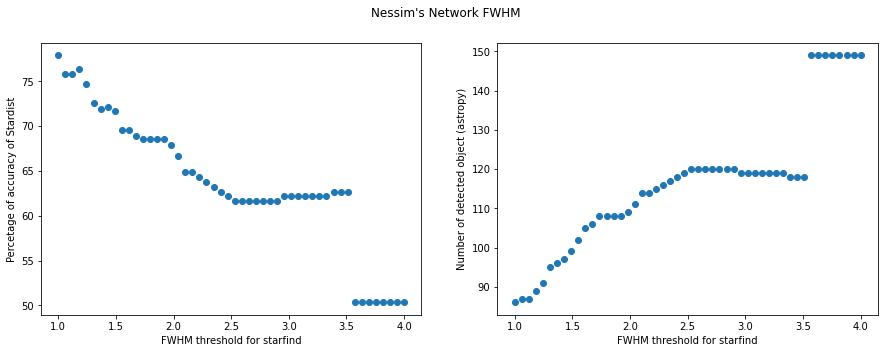

In [20]:
fig,ax = plt.subplots(1,2)

fig.set_size_inches(15,5)

thresh = [i for i in np.linspace(1,4,50)]

ax[0].scatter(thresh,percentage)
ax[0].set_ylabel('Percetage of accuracy of Stardist')
ax[0].set_xlabel('FWHM threshold for starfind')
#ax[0].vlines(4,0,max(percentage),linestyle='--',label='Threshold for accurate astropy detection',alpha=0.8)

ax[1].scatter(thresh,number)
ax[1].set_ylabel('Number of detected object (astropy)')
ax[1].set_xlabel('FWHM threshold for starfind')
#ax[1].vlines(4,0,max(number),linestyle='--',label='Threshold for accurate astropy detection',alpha=0.8)

fig.suptitle("Nessim's Network FWHM")
#plt.savefig("Plots/Nessim_FWHM.png",dpi=300)
plt.show()

## Plot the % of detection per increasing the threshold of intensity detection

In [22]:
percentage = []
number = []

counter = 0 
for i in np.linspace(1,10,50):
    counter += 1
    #print(sum(main('yes',data,lab_moy,256,256,i)))
    #print(len(findstars('e',data,i)))
    print(str(counter)+'/'+str(50))
    percentage.append((sum(main('ye',data,lab_moy,256,256,3,i))/len(findstars('e',data,3,i)))*100)
    number.append(len(findstars('e',data,3,i)))


1/50
2/50
3/50
4/50
5/50
6/50
7/50
8/50
9/50
10/50
11/50
12/50
13/50
14/50
15/50
16/50
17/50
18/50
19/50
20/50
21/50
22/50
23/50
24/50
25/50
26/50
27/50
28/50
29/50
30/50
31/50
32/50
33/50
34/50
35/50
36/50
37/50
38/50
39/50
40/50
41/50
42/50
43/50
44/50
45/50
46/50
47/50
48/50
49/50
50/50


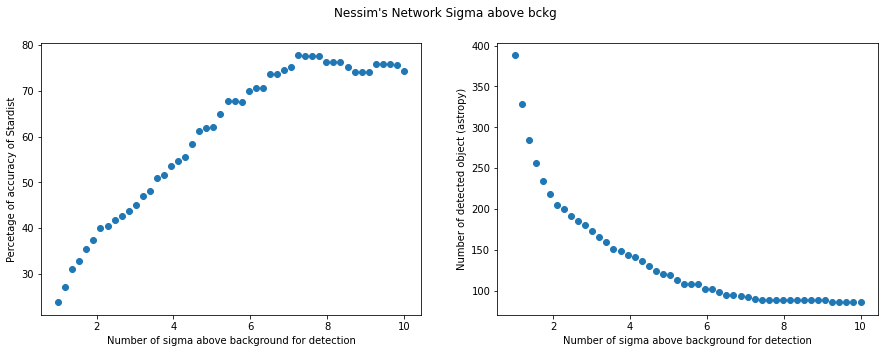

In [24]:
fig,ax = plt.subplots(1,2)

fig.set_size_inches(15,5)

thresh = [j for j in np.linspace(1,10,50)]

ax[0].scatter(thresh,percentage)
ax[0].set_ylabel('Percetage of accuracy of Stardist')
ax[0].set_xlabel('Number of sigma above background for detection')
#ax[0].vlines(8,0,max(percentage),linestyle='--',label='Threshold for accurate astropy detection',alpha=0.8)

ax[1].scatter(thresh,number)
ax[1].set_ylabel('Number of detected object (astropy)')
ax[1].set_xlabel('Number of sigma above background for detection')
#ax[1].vlines(8,0,max(number),linestyle='--',label='Threshold for accurate astropy detection',alpha=0.8)

fig.suptitle("Nessim's Network Sigma above bckg")
#plt.savefig("Plots/Nessim's Network Sigma above bckg.png",dpi=300)
plt.show()

## Grid search for the best fwhm and sigma

In [477]:
percentage = [0]
number = []
thresh = [0,2,3,4,5,6,7,8,9]

counter = 0 
comb = []
for i in np.linspace(1,10,20):
    i += 2
    for j in np.linspace(1,10,20):
        percentage.append((sum(main('ye',data,lab_moy,256,256,i,j))/len(findstars('e',data,i,j)))*100)
        counter += 1
        print(str(counter)+'/'+str((50*50)))
        comb.append([i,j])
        j += 2

1/2500
2/2500
3/2500
4/2500
5/2500
6/2500
7/2500
8/2500
9/2500
10/2500
11/2500
12/2500
13/2500
14/2500
15/2500
16/2500
17/2500
18/2500
19/2500
20/2500
21/2500
22/2500
23/2500
24/2500
25/2500
26/2500
27/2500
28/2500
29/2500
30/2500
31/2500
32/2500
33/2500
34/2500
35/2500
36/2500
37/2500
38/2500
39/2500
40/2500
41/2500
42/2500
43/2500
44/2500
45/2500
46/2500
47/2500
48/2500
49/2500
50/2500
51/2500
52/2500
53/2500
54/2500
55/2500
56/2500
57/2500
58/2500
59/2500
60/2500
61/2500
62/2500
63/2500
64/2500
65/2500
66/2500
67/2500
68/2500
69/2500
70/2500
71/2500
72/2500
73/2500
74/2500
75/2500
76/2500
77/2500
78/2500
79/2500
80/2500
81/2500
82/2500
83/2500
84/2500
85/2500
86/2500
87/2500
88/2500
89/2500
90/2500
91/2500
92/2500
93/2500
94/2500
95/2500
96/2500
97/2500
98/2500
99/2500
100/2500
101/2500
102/2500
103/2500
104/2500
105/2500
106/2500
107/2500
108/2500
109/2500
110/2500
111/2500
112/2500
113/2500
114/2500
115/2500
116/2500
117/2500
118/2500
119/2500
120/2500
121/2500
122/2500
123/2500
1

In [529]:
percentage.index(max(percentage))

print('The best combination of FWHM and threshold is '+ str(comb[percentage.index(max(percentage))]))

The best combination of FWHM and threshold is [3.473684210526316, 8.105263157894736]


In [26]:
print('Thus the best accuracy is '+ str((sum(main('ye',data,lab_moy,256,256,FWHM_best,threshold_best))/len(findstars('e',data,FWHM_best,threshold_best)))*100))

Thus the best accuracy is 77.27272727272727


In [25]:
FWHM_best = 3.473684210526316
threshold_best = 8.105263157894736

### Result of the grid search

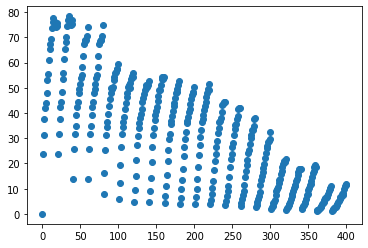

In [479]:
x = [i for i in range(len(percentage))]

plt.scatter(x,percentage)

## Plot the impact of the FWHM and sigma for the 2 networks

In [29]:
lab_a = np.load('../Ali/Outputs/npy_labels/scan_002_RT17_004_ROI_converted_decon_ch00_mask.npy')
lab_moy_a = np.max(lab_a,axis = 0)
#plt.imshow(lab_moy,origin="lower")
print(lab_a.shape)

print('Done!')

(70, 2048, 2048)
Done!


In [44]:
thresh = 5 
percentage_n = []
percentage_a = []
number = []

start = time.time()
for i in np.linspace(1,4,50):
    
    print(str((i/4)*100)+'% done ...')
    
    percentage_n.append((sum(main('ye',data,lab_moy,256,256,i,thresh))/len(findstars('e',data,i,thresh)))*100)    
    percentage_a.append((sum(main('ye',data,lab_moy_a,256,256,i,thresh))/len(findstars('e',data,i,thresh)))*100)
    number.append(len(findstars('e',data,i,thresh)))
    
    
end = time.time() - start

print('This took '+ str(end/60)+' min')

25.0% done ...
26.53061224489796% done ...
28.061224489795915% done ...
29.591836734693878% done ...
31.122448979591837% done ...
32.6530612244898% done ...
34.183673469387756% done ...
35.714285714285715% done ...
37.244897959183675% done ...
38.775510204081634% done ...
40.30612244897959% done ...
41.83673469387755% done ...
43.36734693877551% done ...
44.89795918367347% done ...
46.42857142857143% done ...
47.95918367346938% done ...
49.48979591836735% done ...
51.02040816326531% done ...
52.55102040816326% done ...
54.08163265306123% done ...
55.61224489795919% done ...
57.14285714285714% done ...
58.673469387755105% done ...
60.204081632653065% done ...
61.73469387755102% done ...
63.26530612244898% done ...
64.79591836734694% done ...
66.3265306122449% done ...
67.85714285714286% done ...
69.38775510204081% done ...
70.91836734693877% done ...
72.44897959183673% done ...
73.9795918367347% done ...
75.51020408163265% done ...
77.04081632653062% done ...
78.57142857142857% done ...

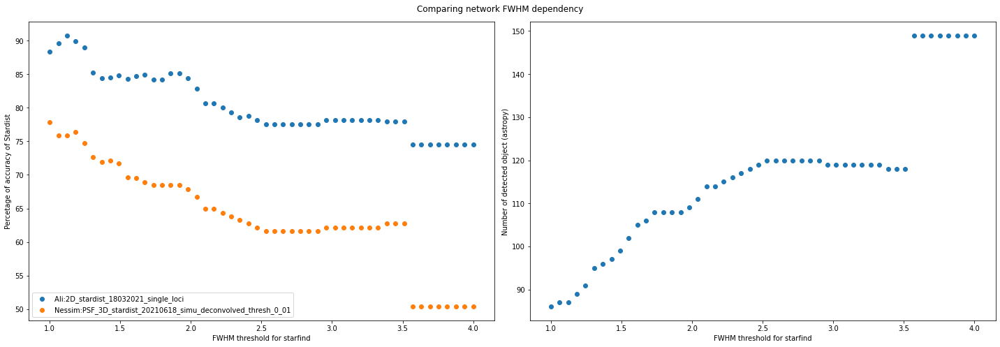

In [54]:
fig,ax = plt.subplots(1,2)

fig.set_size_inches(20,7)
x = 0.1
y = 1.1

thresh = [i for i in np.linspace(1,4,50)]

ax[0].scatter(thresh,percentage_a,label="Ali:2D_stardist_18032021_single_loci ")
ax[0].scatter(thresh,percentage_n,label="Nessim:PSF_3D_stardist_20210618_simu_deconvolved_thresh_0_01")
ax[0].set_ylabel('Percetage of accuracy of Stardist')
ax[0].set_xlabel('FWHM threshold for starfind')
ax[0].legend(loc="lower left")#bbox_to_anchor=(x,y))


ax[1].scatter(thresh,number)
ax[1].set_ylabel('Number of detected object (astropy)')
ax[1].set_xlabel('FWHM threshold for starfind')

fig.suptitle("Comparing network FWHM dependency")
plt.tight_layout()
plt.savefig("Plots/Comparing_Networks_FWHM_dependency.png",dpi=300)
plt.show()

### x*Mean above bckg

In [39]:
percentage_n = []
percentage_a = []
number = []

FWHM = 3 

counter = 0 
for i in np.linspace(1,10,50):
    counter += 1
    print(str(counter)+'/'+str(50))
    percentage_n.append((sum(main('ye',data,lab_moy,256,256,FWHM,i))/len(findstars('e',data,FWHM,i)))*100)
    percentage_a.append((sum(main('ye',data,lab_moy_a,256,256,FWHM,i))/len(findstars('e',data,FWHM,i)))*100)
    
    number.append(len(findstars('e',data,3,i)))


1/50
2/50
3/50
4/50
5/50
6/50
7/50
8/50
9/50
10/50
11/50
12/50
13/50
14/50
15/50
16/50
17/50
18/50
19/50
20/50
21/50
22/50
23/50
24/50
25/50
26/50
27/50
28/50
29/50
30/50
31/50
32/50
33/50
34/50
35/50
36/50
37/50
38/50
39/50
40/50
41/50
42/50
43/50
44/50
45/50
46/50
47/50
48/50
49/50
50/50


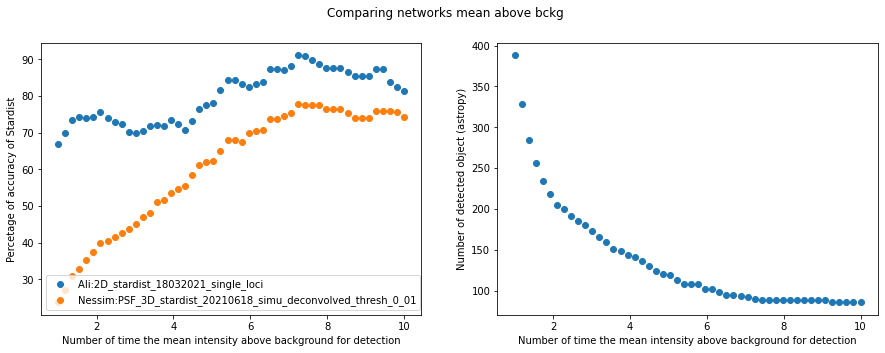

In [43]:
fig,ax = plt.subplots(1,2)

fig.set_size_inches(15,5)

thresh = [j for j in np.linspace(1,10,50)]

x = 0.1
y = 1.1

ax[0].scatter(thresh,percentage_a,label="Ali:2D_stardist_18032021_single_loci ")
ax[0].scatter(thresh,percentage_n,label="Nessim:PSF_3D_stardist_20210618_simu_deconvolved_thresh_0_01")
ax[0].set_ylabel('Percetage of accuracy of Stardist')
ax[0].set_xlabel('Number of time the mean intensity above background for detection')
ax[0].legend(loc="best")#bbox_to_anchor=(x,y))


ax[1].scatter(thresh,number)
ax[1].set_ylabel('Number of detected object (astropy)')
ax[1].set_xlabel('Number of time the mean intensity above background for detection')

fig.suptitle("Comparing networks mean above bckg")
#plt.savefig("Plots/Comparing_networks_mean_above_bckg.png",dpi=300)
plt.show()

# modifying an image

### Find an image that has to be corrected (where astropy detected something stardist didn't)

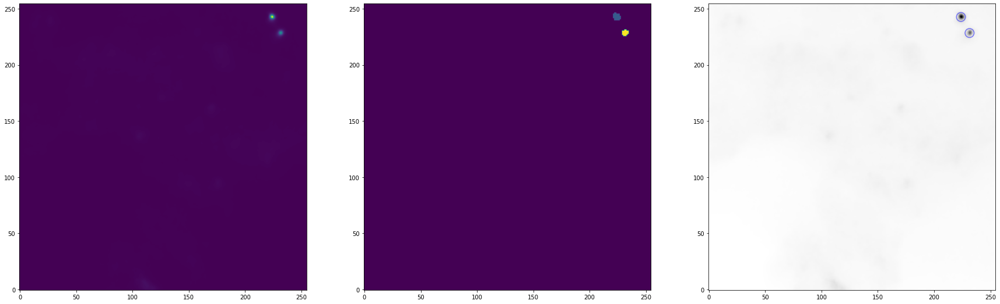

The mean intensity for that image is 96
This is image 0


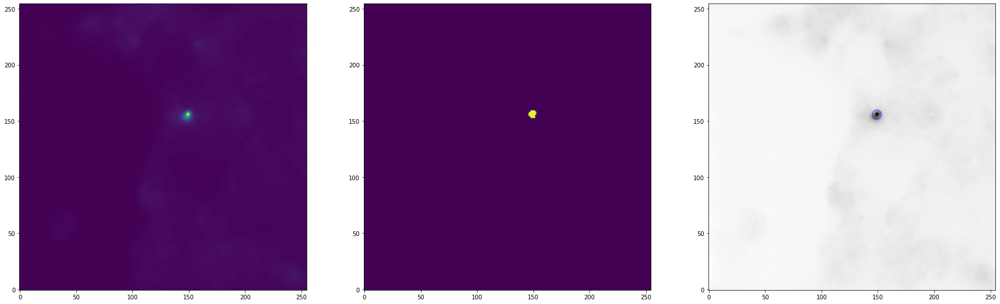

The mean intensity for that image is 144
This is image 1
The mean intensity for that image is 77
This is image 2


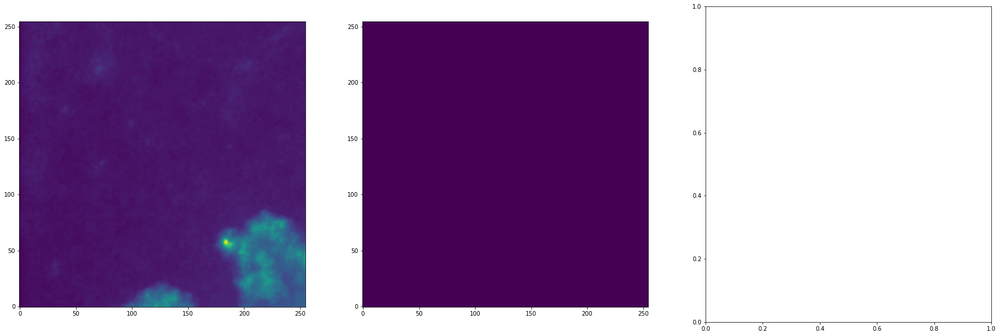

The mean intensity for that image is 77
This is image 3


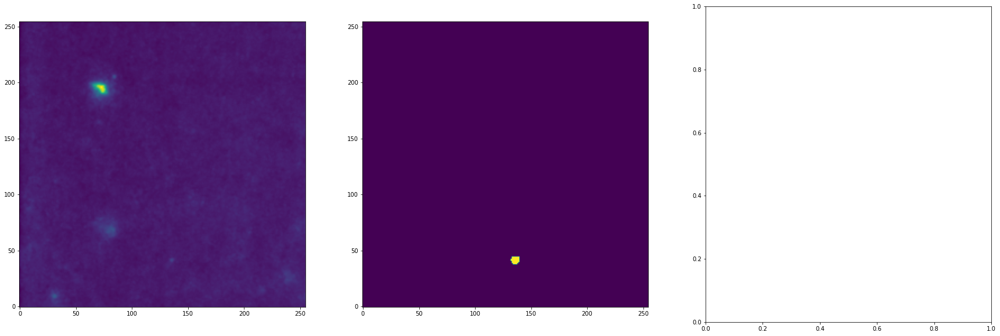

The mean intensity for that image is 76
This is image 4


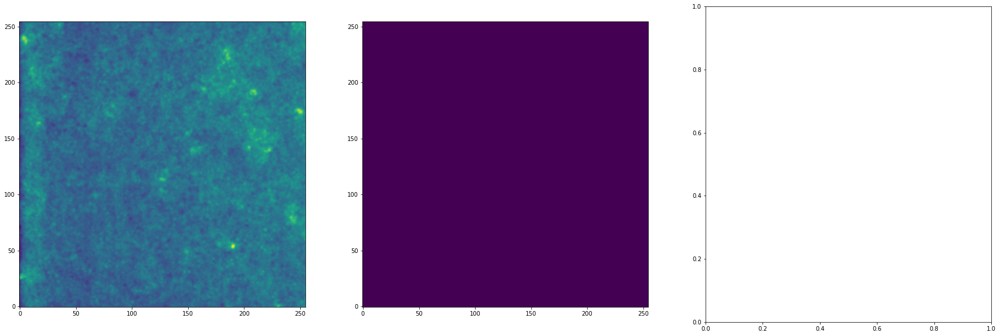

The mean intensity for that image is 72
This is image 5


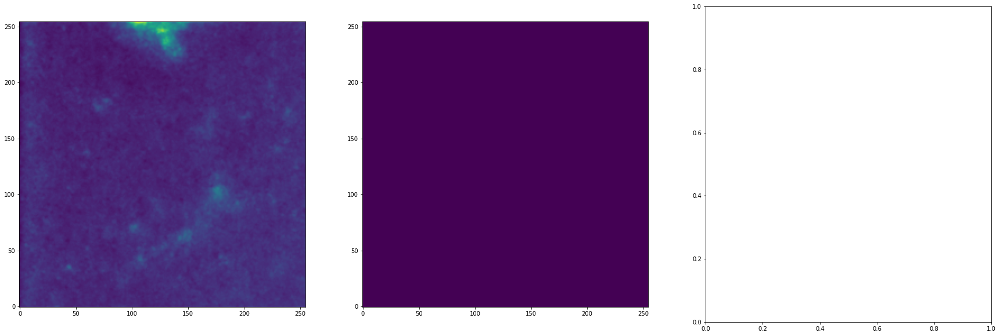

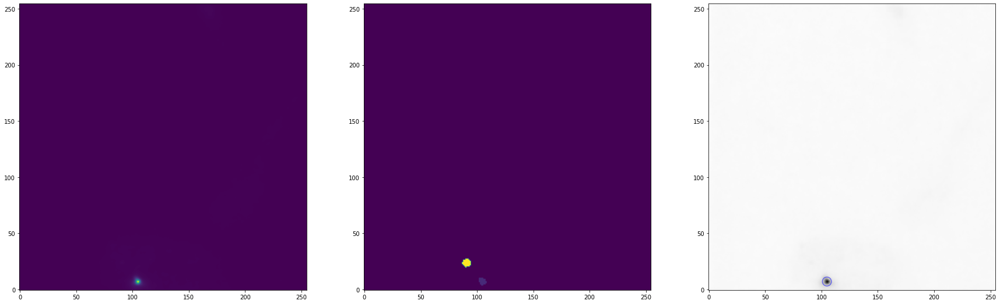

The mean intensity for that image is 61
This is image 6
The mean intensity for that image is 53
This is image 7


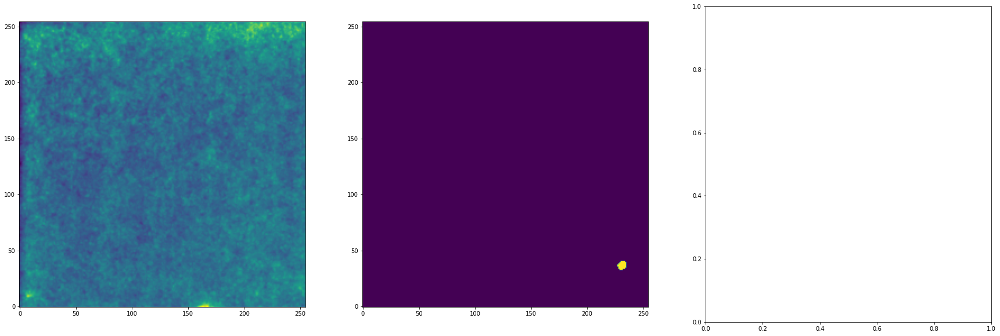

The mean intensity for that image is 152
This is image 8


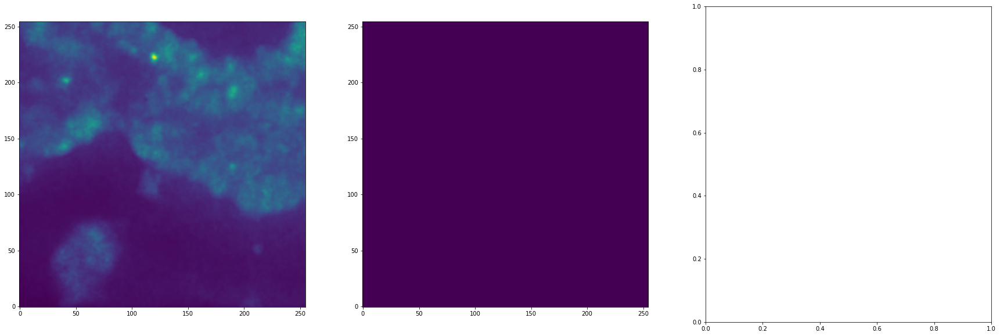

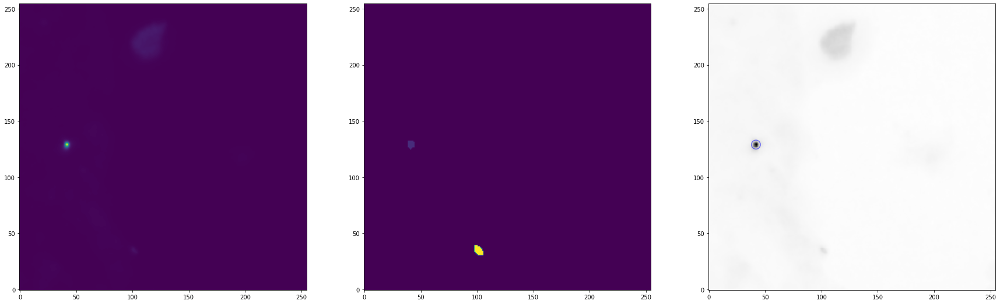

The mean intensity for that image is 144
This is image 9
The mean intensity for that image is 88
This is image 10


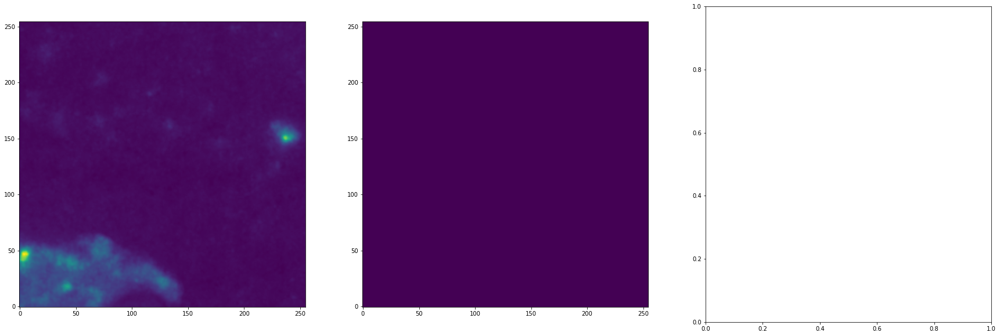

The mean intensity for that image is 89
This is image 11


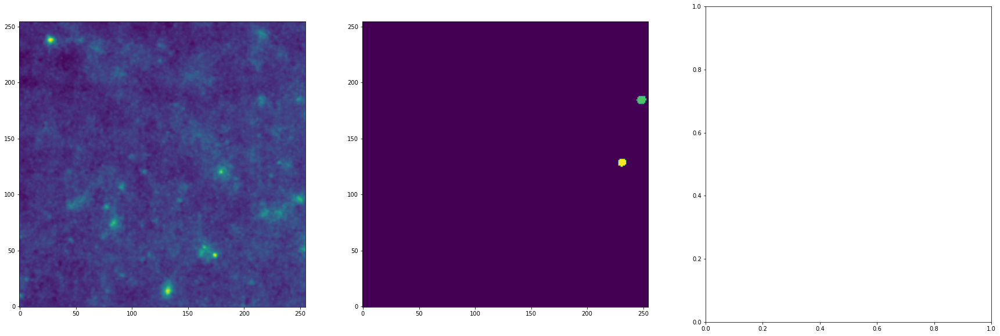

The mean intensity for that image is 87
This is image 12


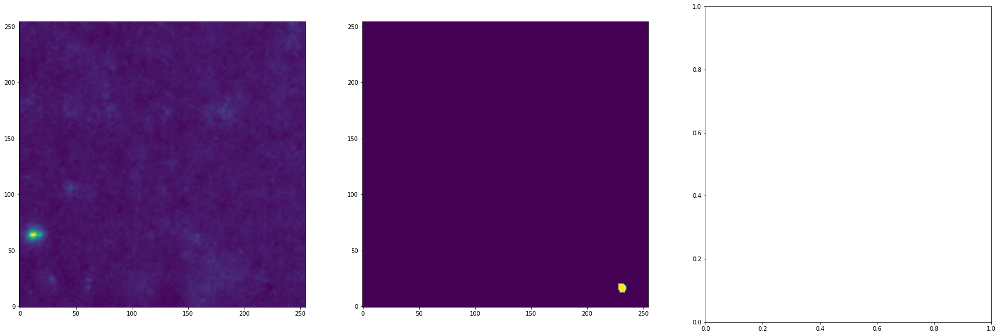

The mean intensity for that image is 81
This is image 13


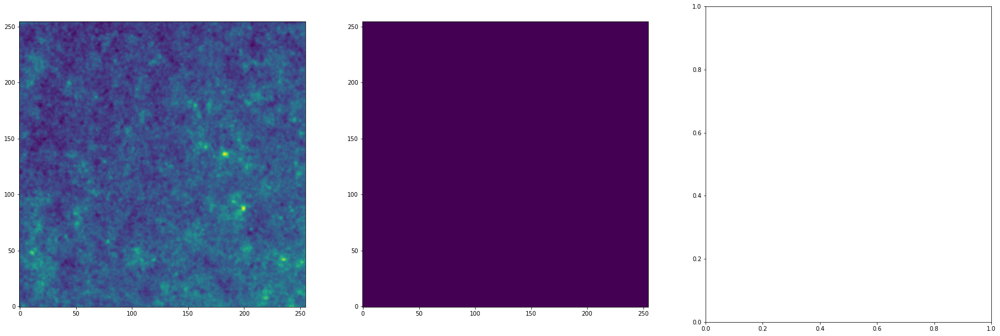

The mean intensity for that image is 69
This is image 14


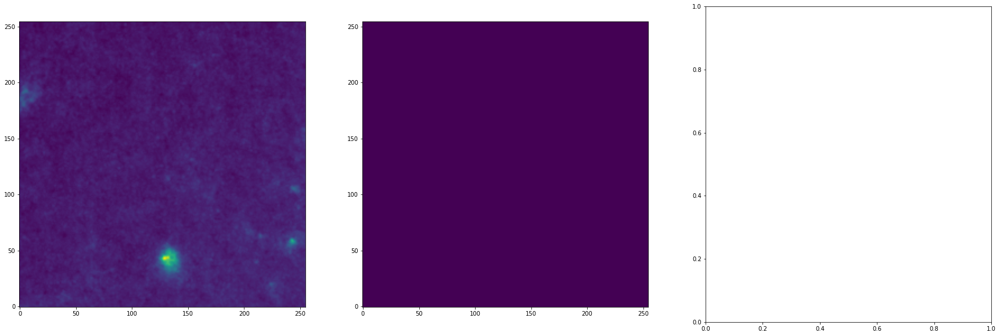

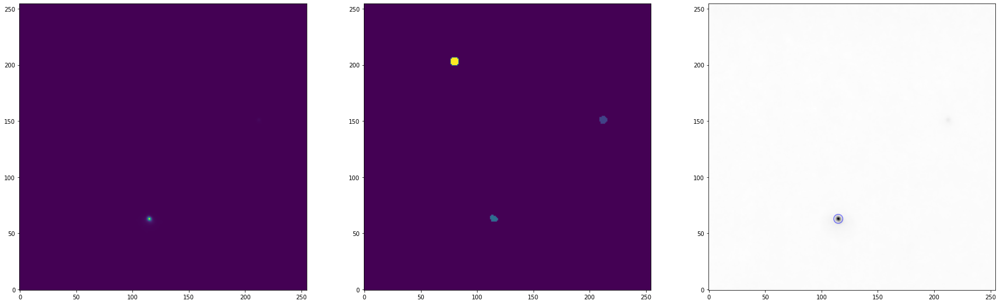

The mean intensity for that image is 59
This is image 15
The mean intensity for that image is 82
This is image 16


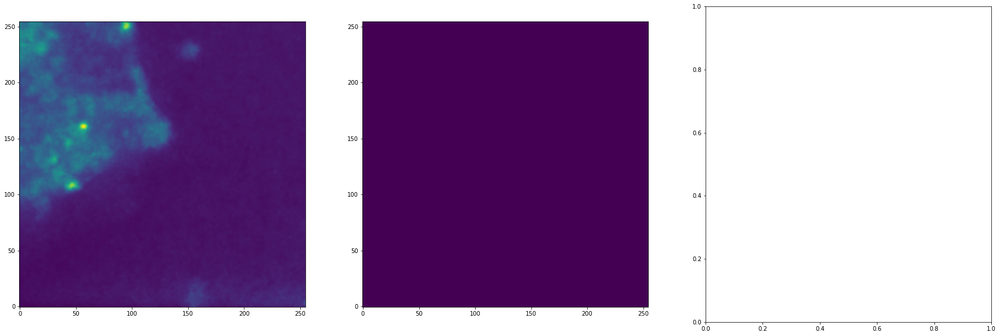

The mean intensity for that image is 80
This is image 17


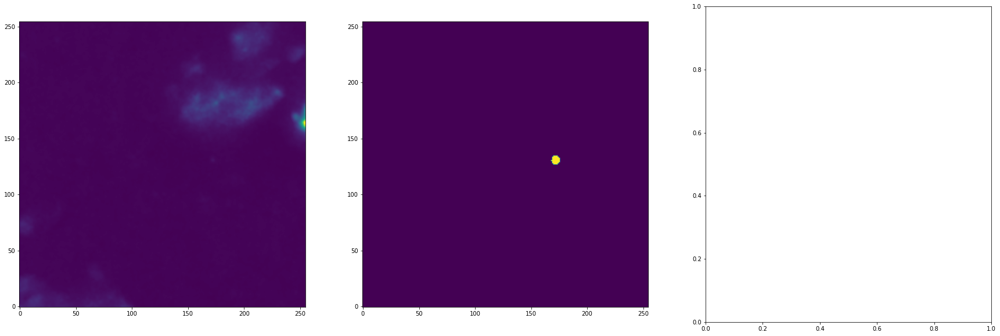

The mean intensity for that image is 93
This is image 18


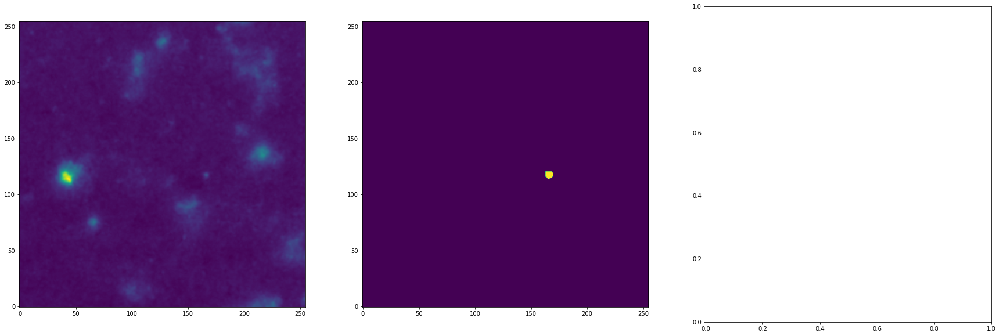

The mean intensity for that image is 97
This is image 19


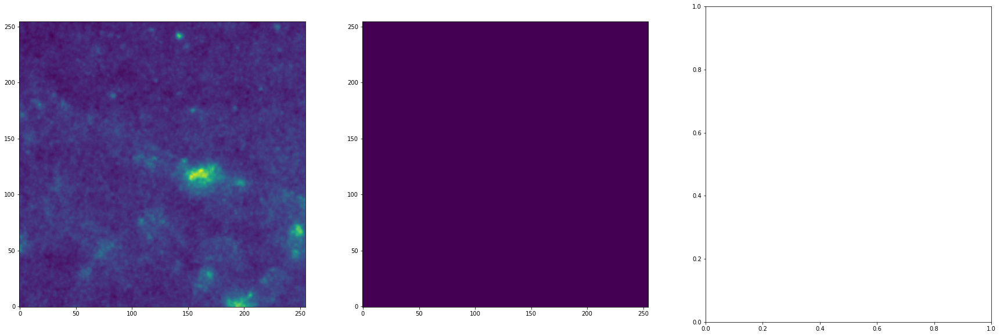

The mean intensity for that image is 94
This is image 20


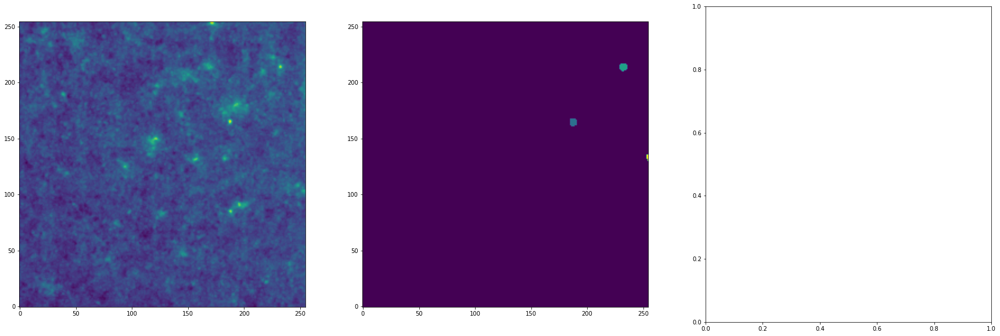

The mean intensity for that image is 90
This is image 21


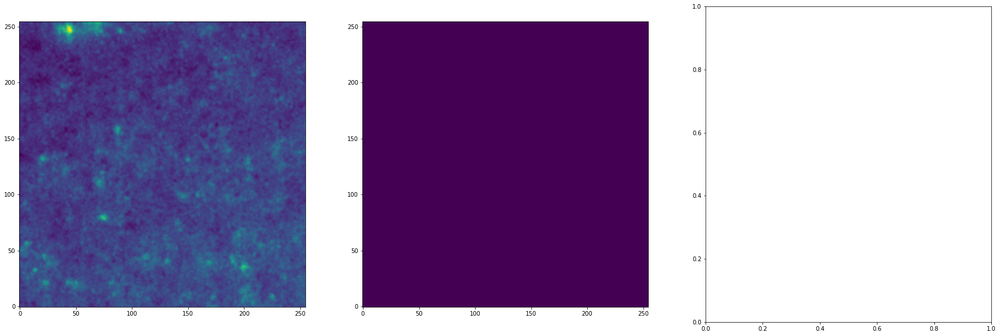

The mean intensity for that image is 77
This is image 22


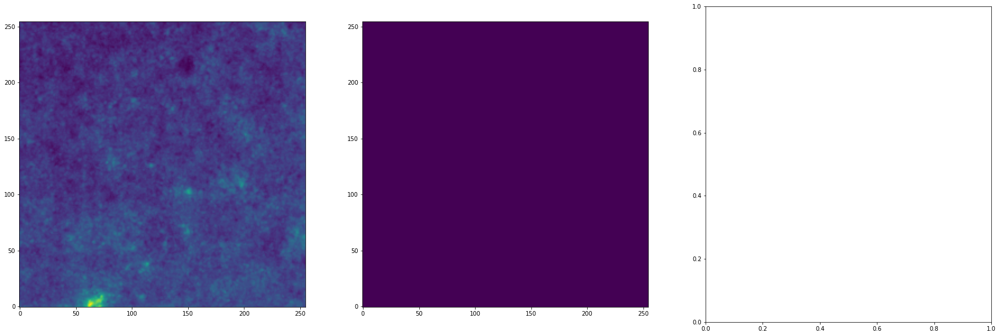

The mean intensity for that image is 64
This is image 23


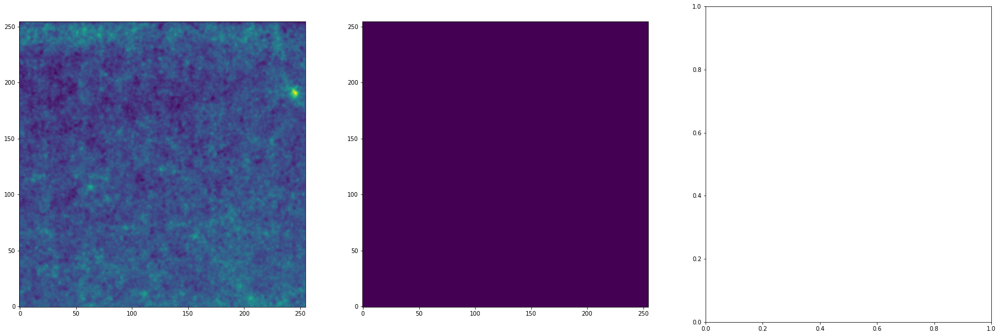

The mean intensity for that image is 82
This is image 24


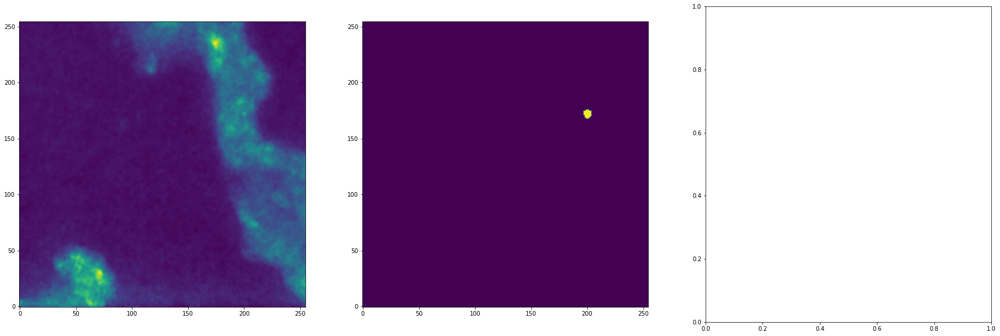

The mean intensity for that image is 98
This is image 25


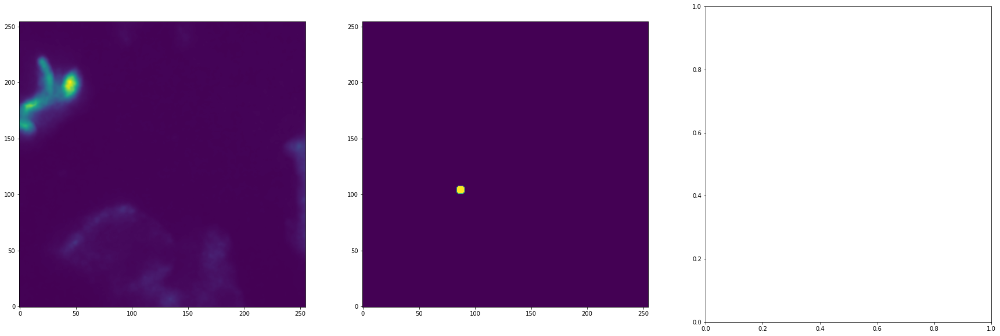

The mean intensity for that image is 101
This is image 26


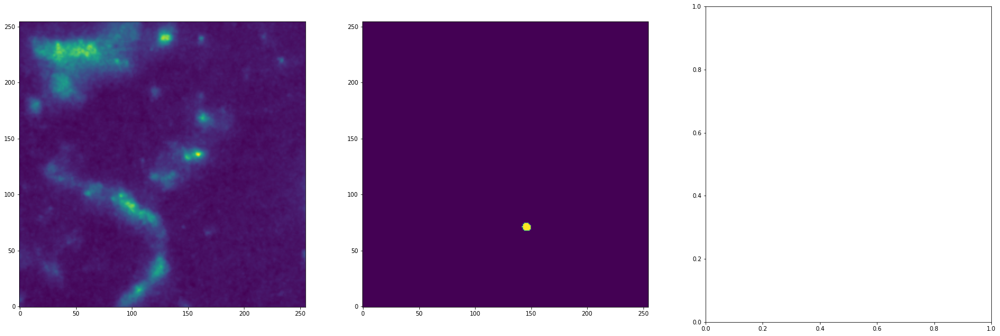

The mean intensity for that image is 103
This is image 27


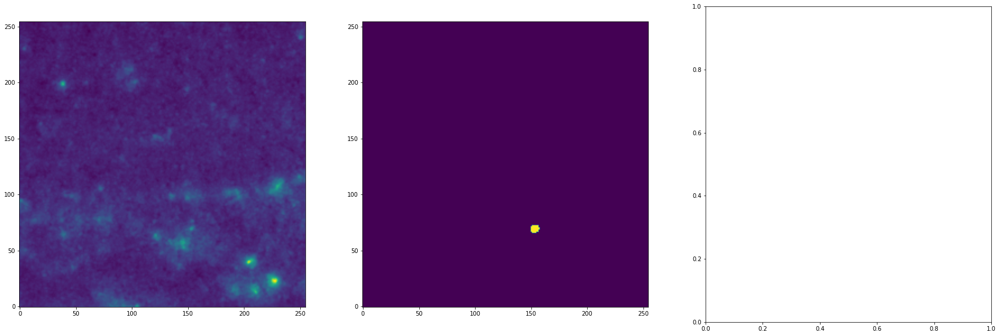

The mean intensity for that image is 99
This is image 28


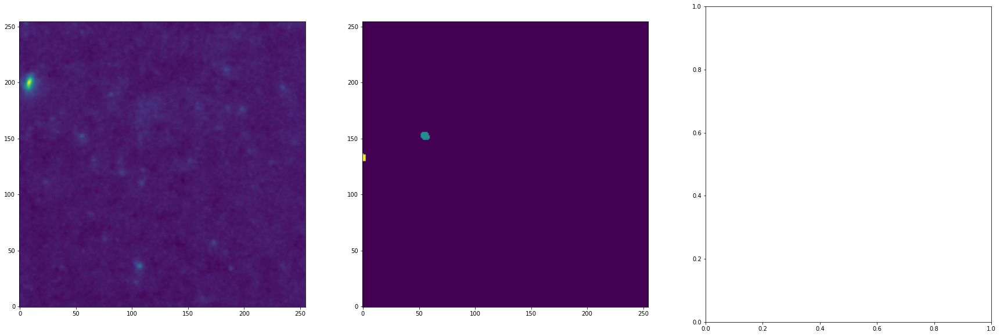

The mean intensity for that image is 95
This is image 29


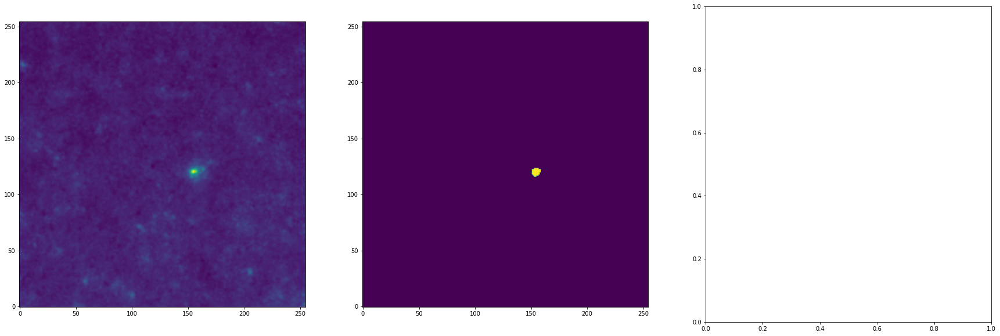

The mean intensity for that image is 80
This is image 30


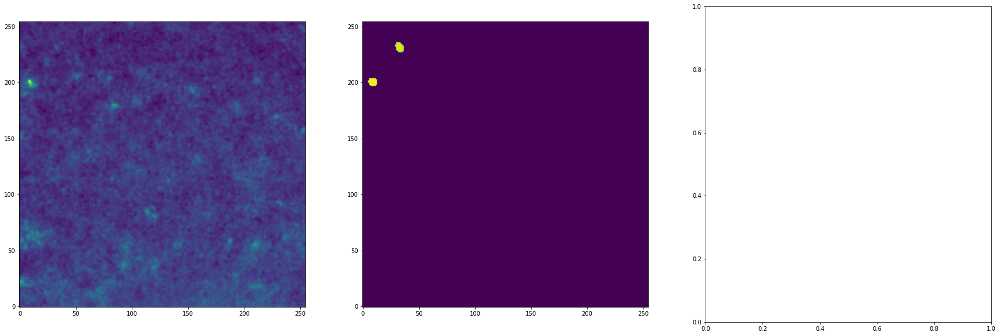

The mean intensity for that image is 68
This is image 31


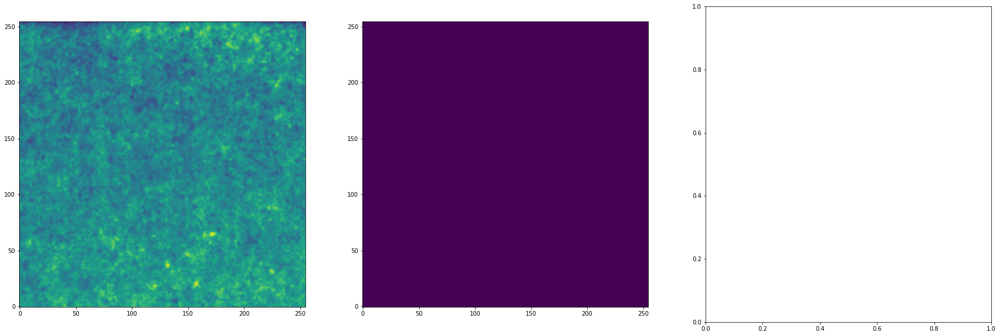

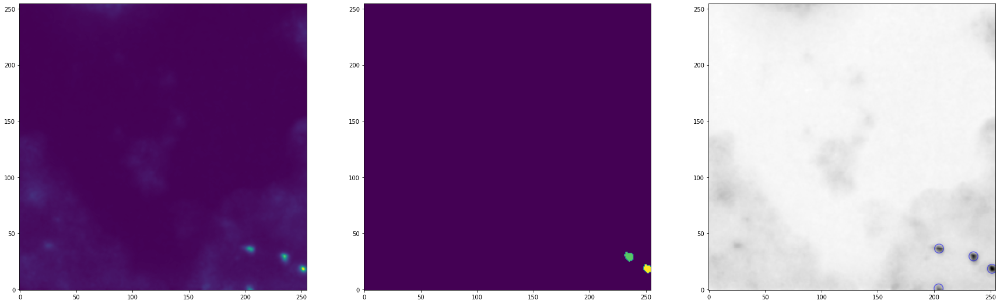

The mean intensity for that image is 110
This is image 32


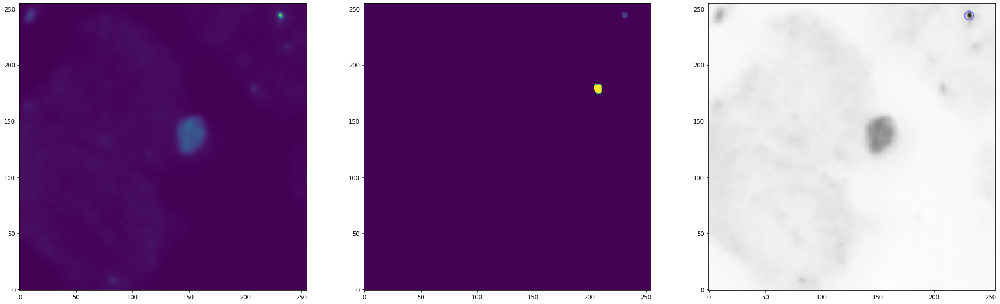

The mean intensity for that image is 305
This is image 33
The mean intensity for that image is 160
This is image 34


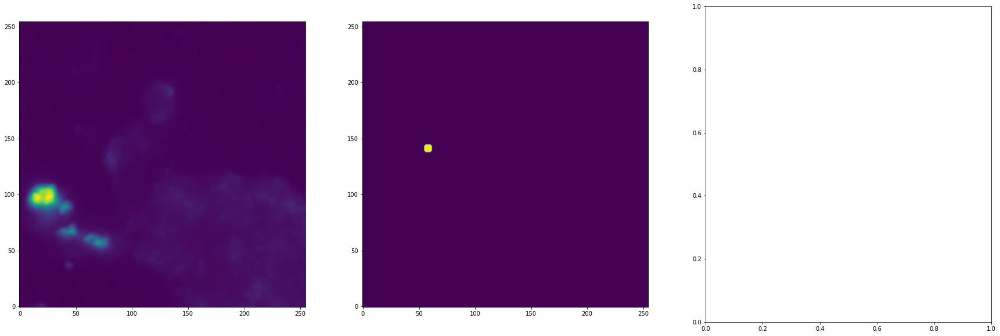

The mean intensity for that image is 103
This is image 35


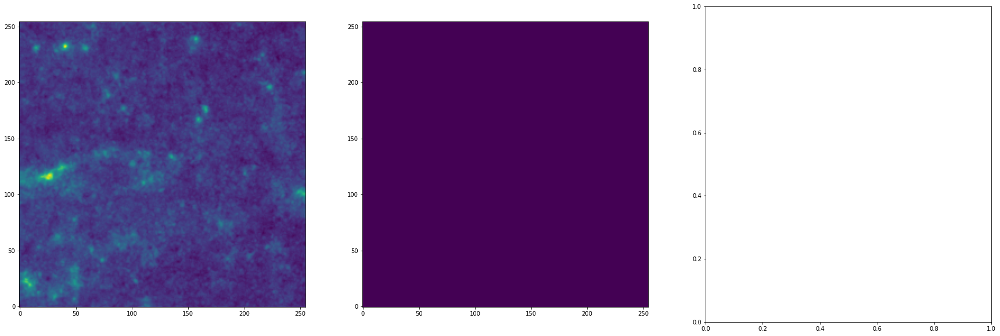

The mean intensity for that image is 101
This is image 36


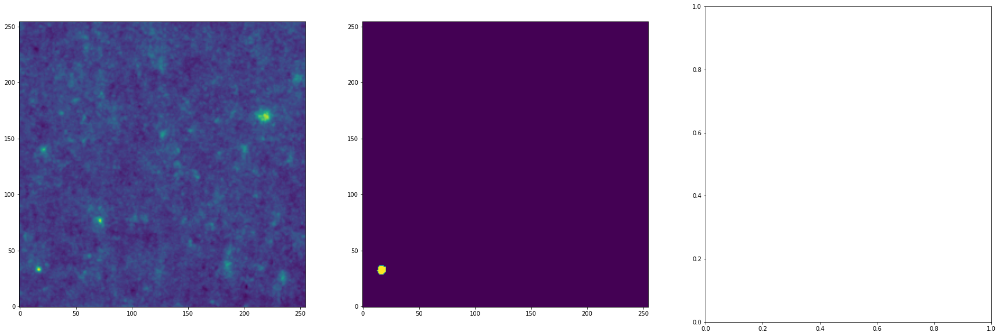

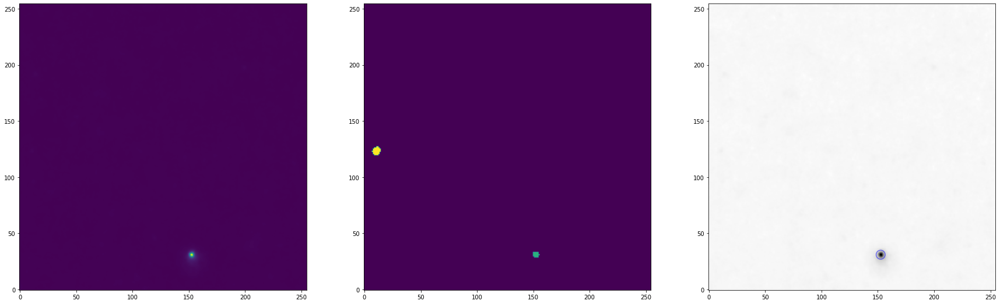

The mean intensity for that image is 96
This is image 37
The mean intensity for that image is 82
This is image 38


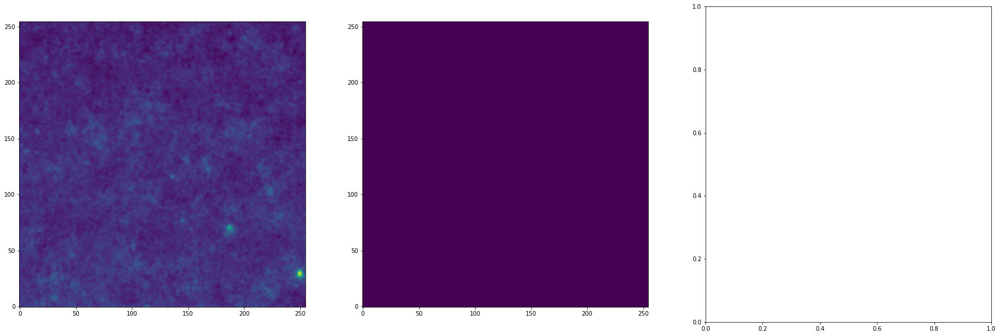

The mean intensity for that image is 70
This is image 39


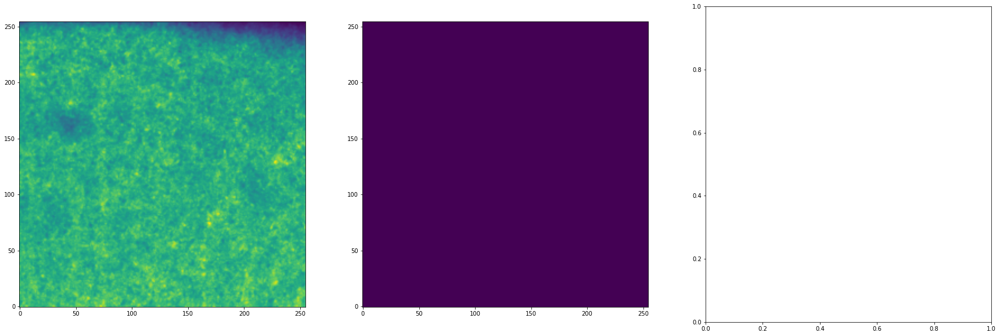

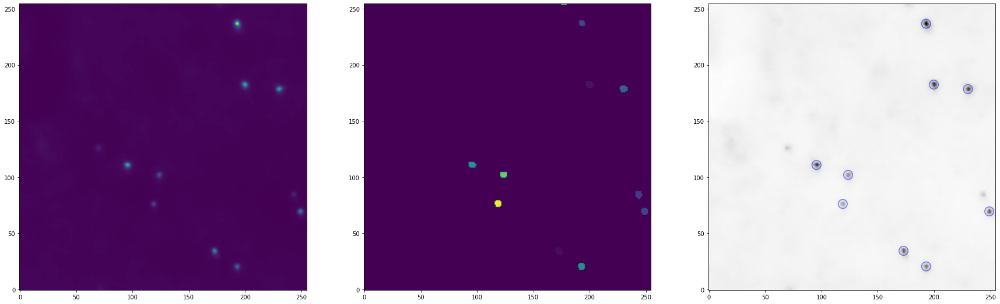

The mean intensity for that image is 236
This is image 40


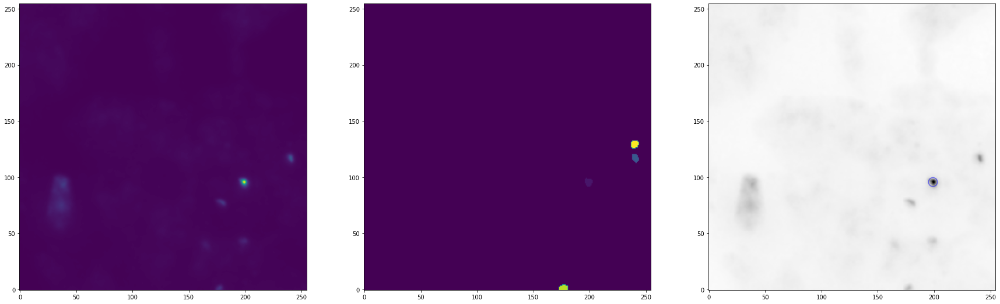

The mean intensity for that image is 254
This is image 41
The mean intensity for that image is 124
This is image 42


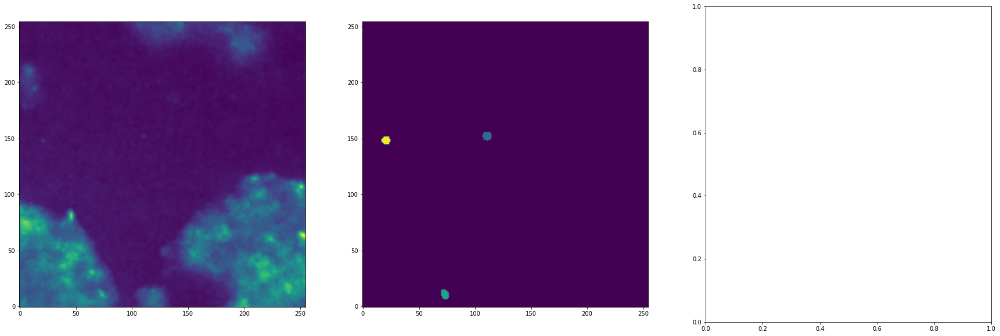

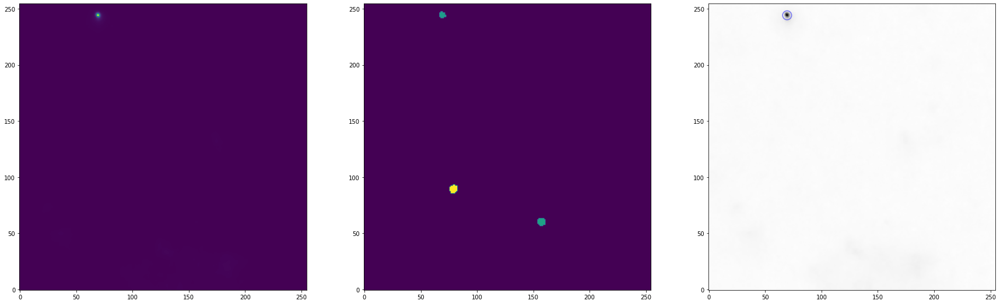

The mean intensity for that image is 93
This is image 43
The mean intensity for that image is 94
This is image 44


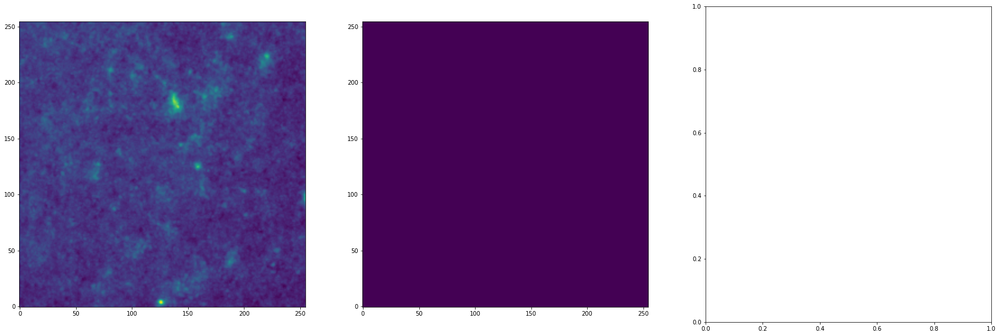

The mean intensity for that image is 91
This is image 45


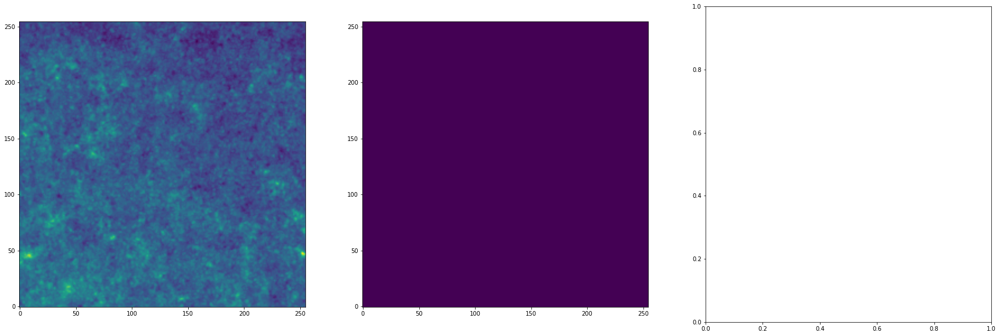

The mean intensity for that image is 78
This is image 46


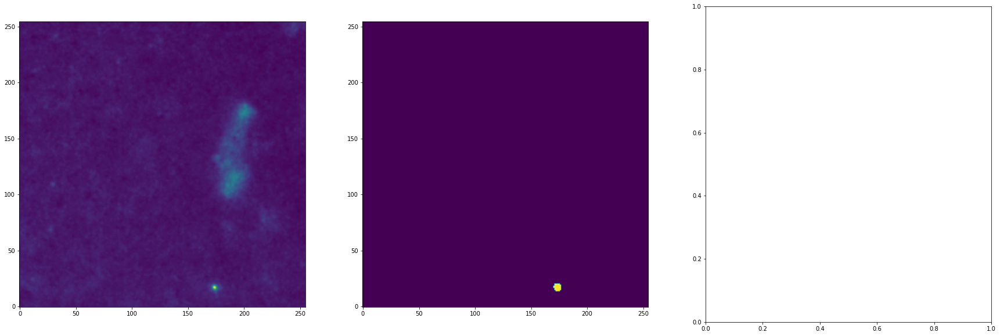

The mean intensity for that image is 67
This is image 47


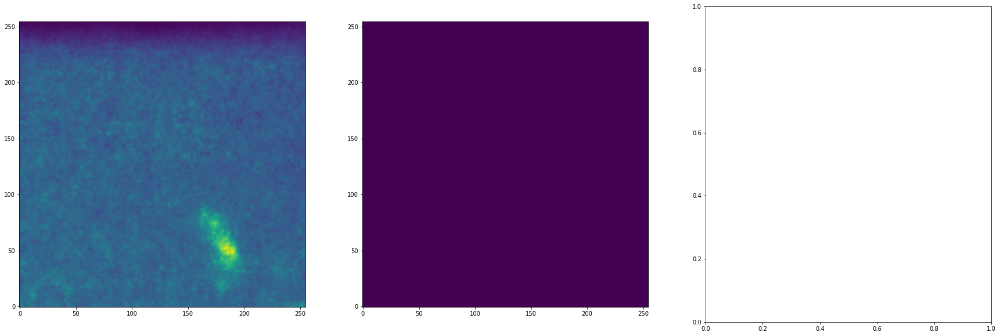

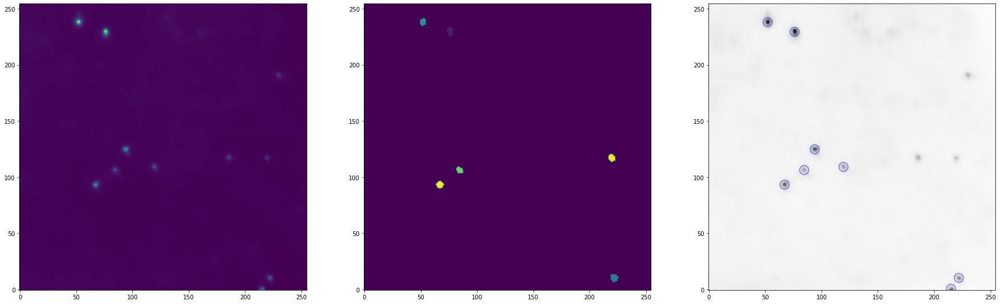

The mean intensity for that image is 164
This is image 48


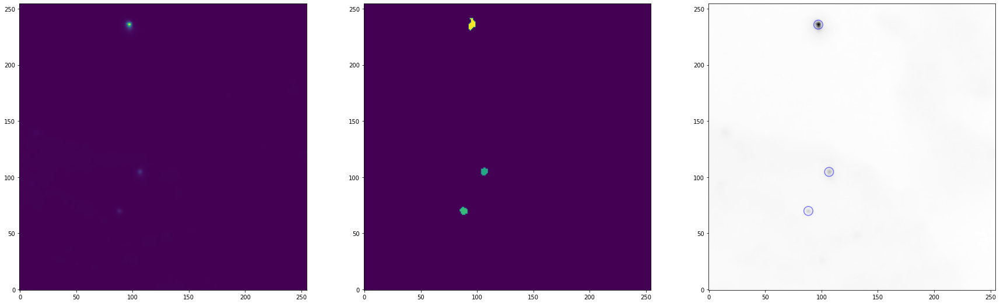

The mean intensity for that image is 163
This is image 49
The mean intensity for that image is 93
This is image 50


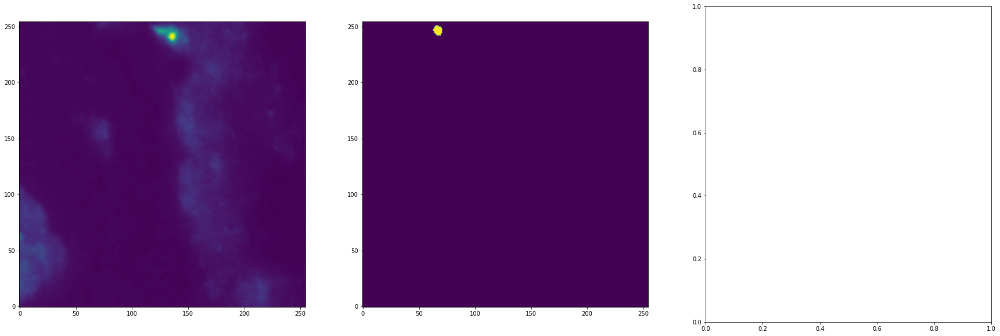

The mean intensity for that image is 111
This is image 51


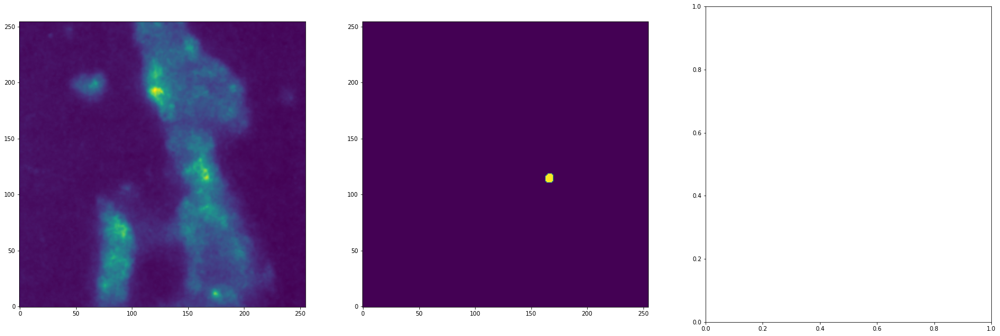

The mean intensity for that image is 84
This is image 52


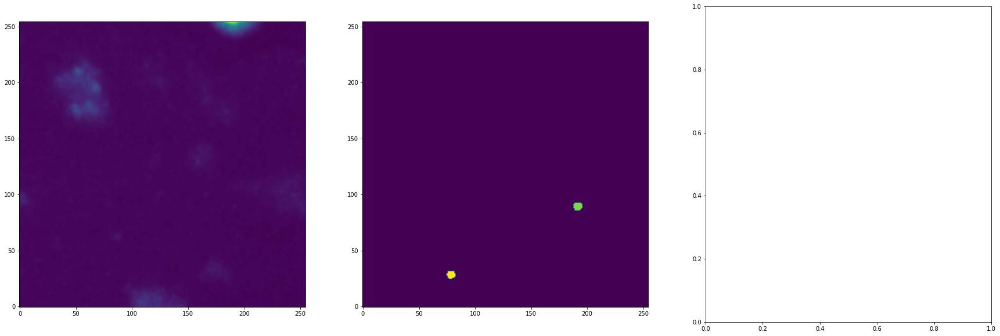

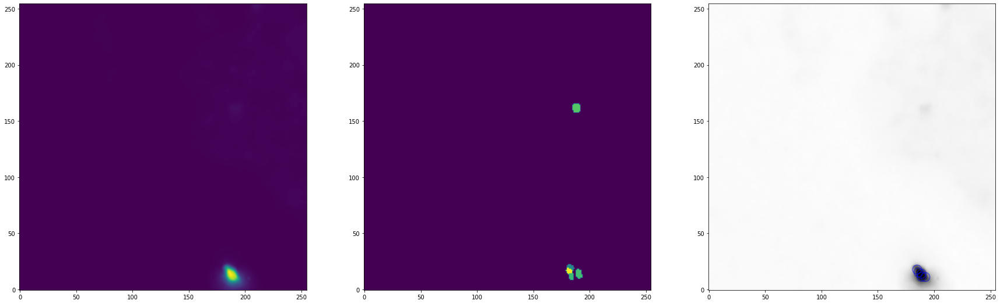

The mean intensity for that image is 106
This is image 53


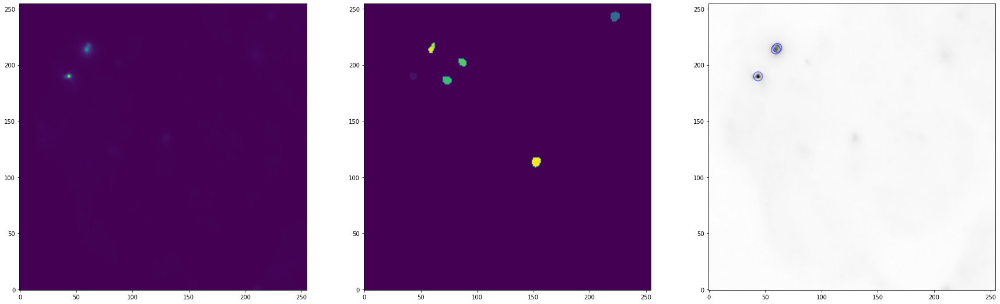

The mean intensity for that image is 146
This is image 54


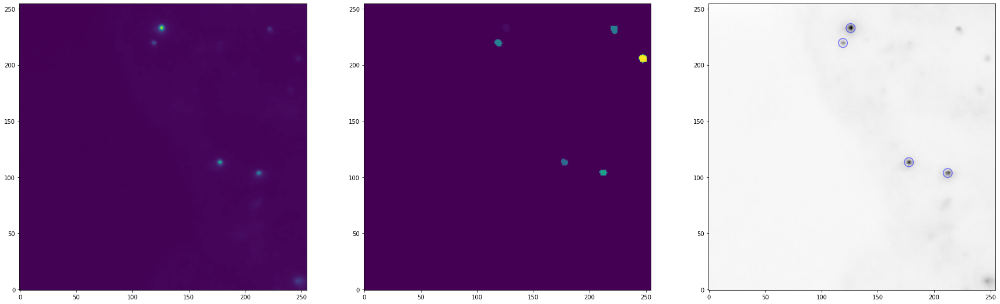

The mean intensity for that image is 113
This is image 55


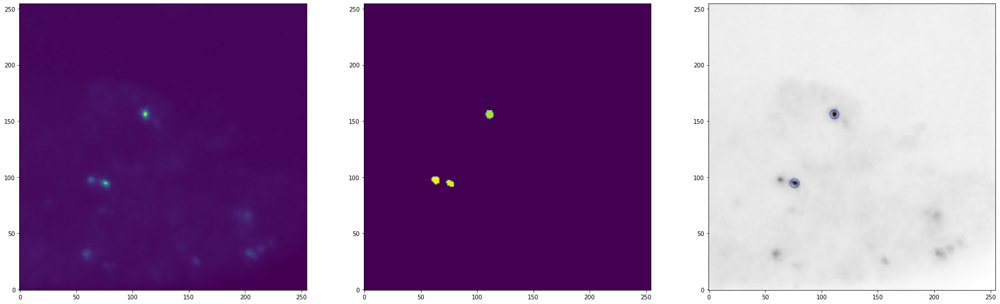

The mean intensity for that image is 82
This is image 56
The mean intensity for that image is 59
This is image 57


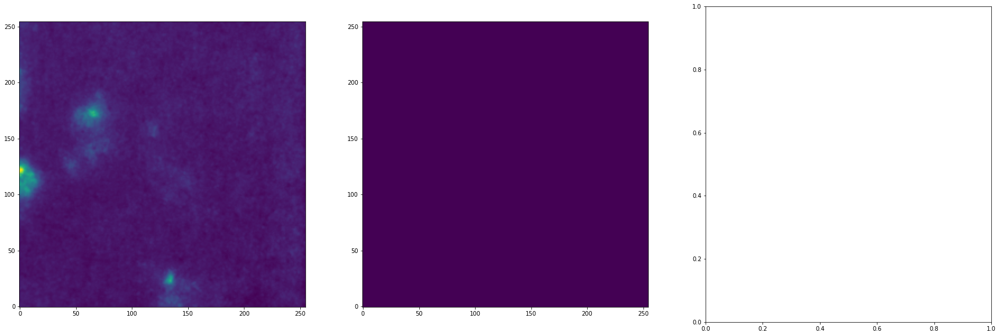

The mean intensity for that image is 66
This is image 58


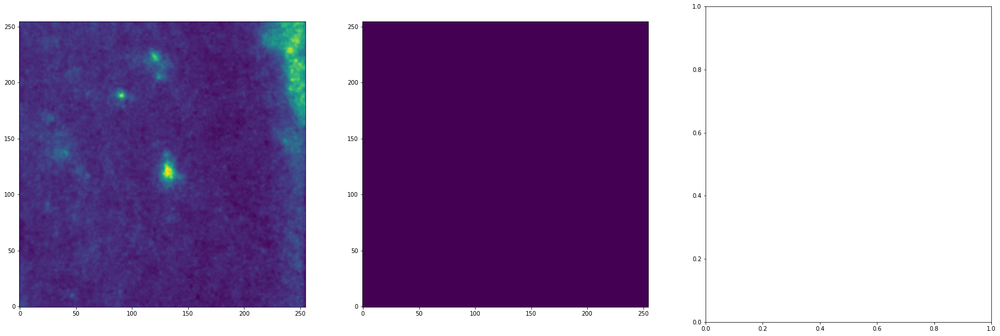

The mean intensity for that image is 69
This is image 59


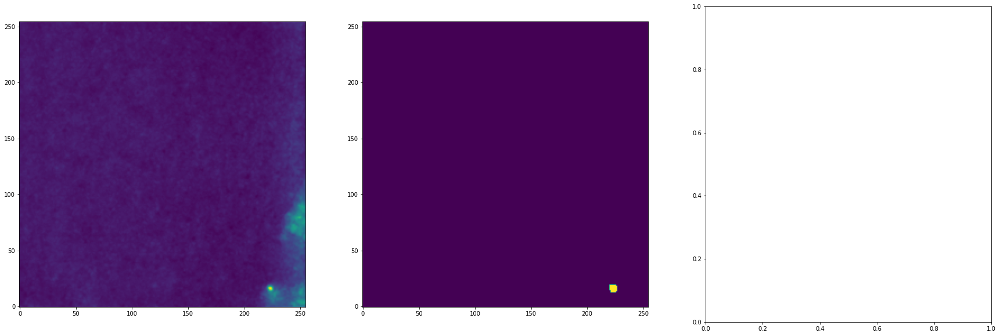

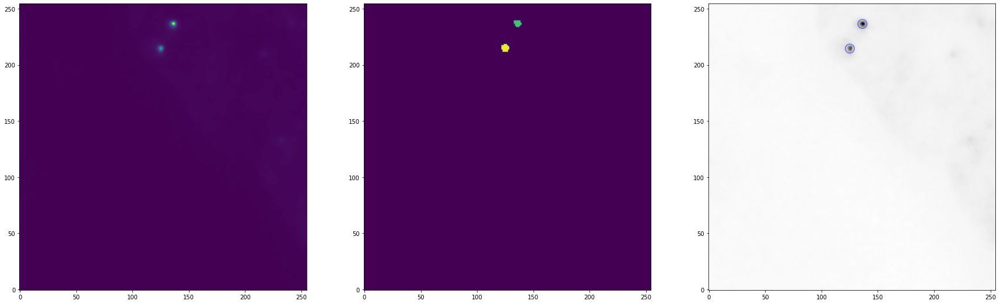

The mean intensity for that image is 106
This is image 60


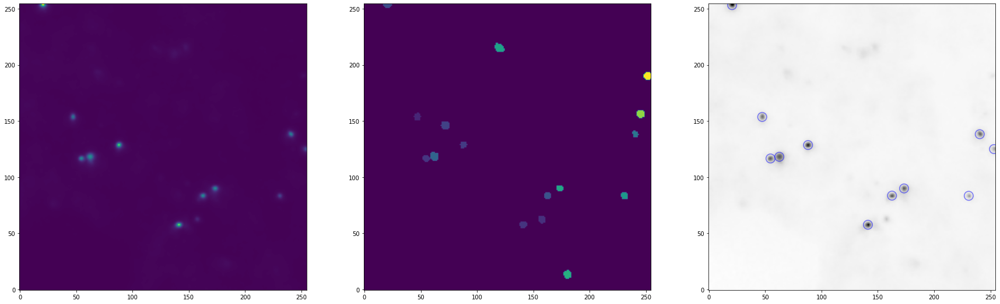

The mean intensity for that image is 195
This is image 61


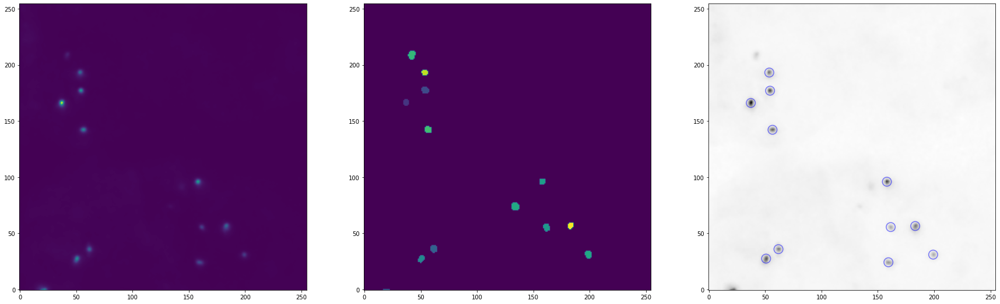

The mean intensity for that image is 148
This is image 62


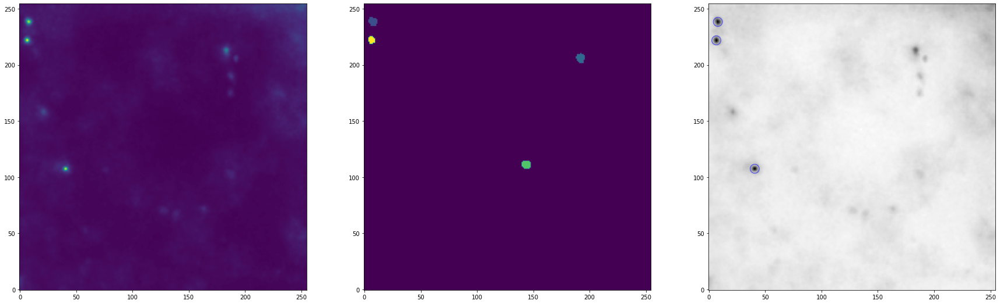

The mean intensity for that image is 146
This is image 63


In [130]:


p = 'yes'

for i in range(64):
    
    figure(figsize=(30,10))
    
    plt.subplot(1,3,1)
    
    plt.imshow(images[i],origin="lower")
    #plt.hist(images[i])

    plt.subplot(1,3,2)
    
    plt.imshow(labs[i],origin="lower")

    plt.subplot(1,3,3)
    
    m = findstars(p,images[i],FWHM_best,9)

    print('The mean intensity for that image is ' + str(round(m[1])))
    print('This is image '+ str(i))
    
    plt.show()

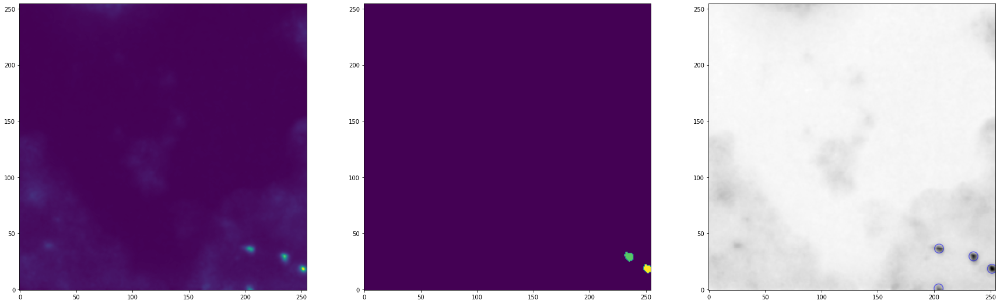

The mean intensity for that image is 110


In [131]:
i = 32

figure(figsize=(30,10))
    
plt.subplot(1,3,1)

plt.imshow(images[i],origin="lower")
#plt.hist(images[i])

plt.subplot(1,3,2)

plt.imshow(labs[i],origin="lower")

plt.subplot(1,3,3)

m = findstars(p,images[i],FWHM_best,9)

print('The mean intensity for that image is ' + str(round(m[1])))

### Try to modi fy it 

### First thing is to create a template sphere function that will create a sphere 

In [431]:
def sphere(height,center,size,radius,fill):
    img = np.zeros((height*2,size[0], size[1]), dtype=np.uint8) # create an empty matrix
    for i in range(2):
        counter = height #reset the counter to go back to the middle
        if i == 0: #loop twice to fill both side of the sphere
            for j in range(height):
                #print(radius-(j*1))
                rr, cc = disk((center[0], center[1]), radius-(j*1)) # create a disk 
                img[counter,rr, cc] = fill # fill the disk with a number
                counter +=1
        if i == 1:
            for j in range(height):
                #print(radius-(j*1))
                rr, cc = disk((center[0], center[1]), radius-(j*1))  
                img[counter,rr, cc] = fill 
                counter -=1
    return img

(8, 10, 10)
255


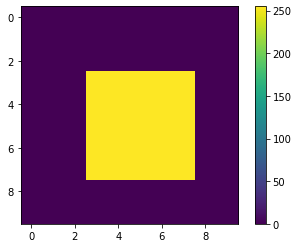

In [434]:
# testing
s = sphere(4,(5,5),(10,10),3,255)

print(np.shape(s))
test = np.max(s,axis=0)

plt.imshow(test)
print(np.max(test))
plt.colorbar()
plt.show()

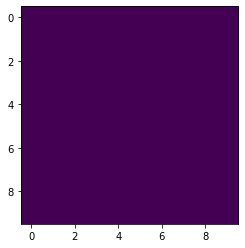

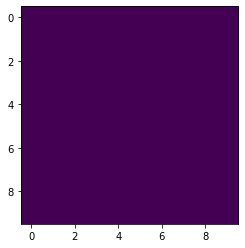

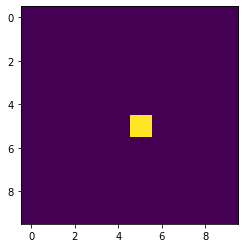

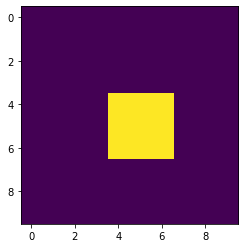

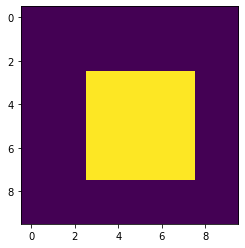

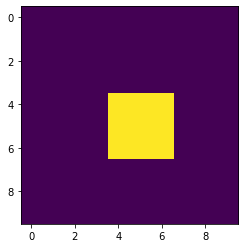

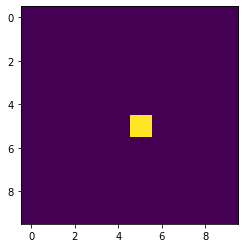

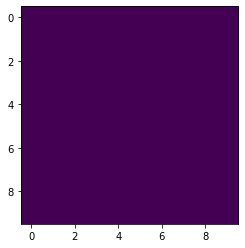

In [435]:
# visualizing the sphere in stacks 

for i in range(8):
    plt.imshow(s[i])
    plt.show()
    

In [436]:
# for fun create a gif

def make_gif(frame):
    frames = [Image.fromarray(image) for image in frame]
    frame_one = frames[0]
    frame_one.save("my_awesome.gif", format="GIF", append_images=frames,
               save_all=True, duration=400, loop=0)
    
frame = [s[i] for i in range(8)]

make_gif(frame)

### Now that we have a template and an image to modify we can modify it

In [449]:
lab = np.load('Outputs/labeled/scan_002_RT17_004_ROI_converted_decon_ch00_mask.npy')
lab_moy = np.max(lab,axis = 0)

positions = findstars('t',images[32],FWHM_best,threshold_best) #the positions of the starfind objects 
test_image = images[32].copy() #the raw image
test_labs = labs[32].copy() #the labeled image 

s = sphere(4,(5,5),(10,10),3,100) # the sphere 


test_sphere = np.max(s,axis=0) #the 2D sphere (we work in 2D)


#plt.imshow(test_labs,origin='lower') #plot for testing
#plt.show()


31 41 199 209


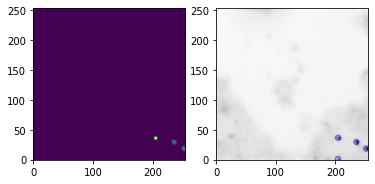

In [450]:
counter = 0
for pos in positions:
    x = round(list(pos)[1])
    y = round(list(pos)[0])
    
    if test_labs[x,y] <= 1:
        if x ==1 or y == 1:
            counter = 1 
        else:
            print(x-5,x+5,y-5,y+5)
            test_labs[x-5:x+5,y-5:y+5] = test_sphere
            plt.subplot(1,2,1)
            plt.imshow(test_labs,origin = "lower")
            plt.subplot(1,2,2)
            findstars('yes',images[32],FWHM_best,threshold_best)
            plt.show()

### 1. Make it a function 

In [350]:
def correction(positions,lab_img,sphere,):
    counter = 0
    for pos in positions:
        x = round(list(pos)[1])
        y = round(list(pos)[0])

        if test_labs[x,y] <= 1:
            if x ==1 or y == 1:
                counter = 1 
            else:
                print(x-5,x+5,y-5,y+5)
                test_labs[x-5:x+5,y-5:y+5] = test_sphere
                

## New something to test : create a template sphere from the "well detected" objects

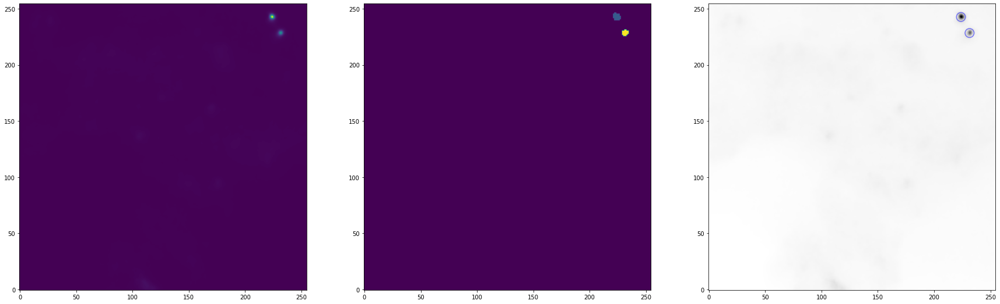

This is image 0


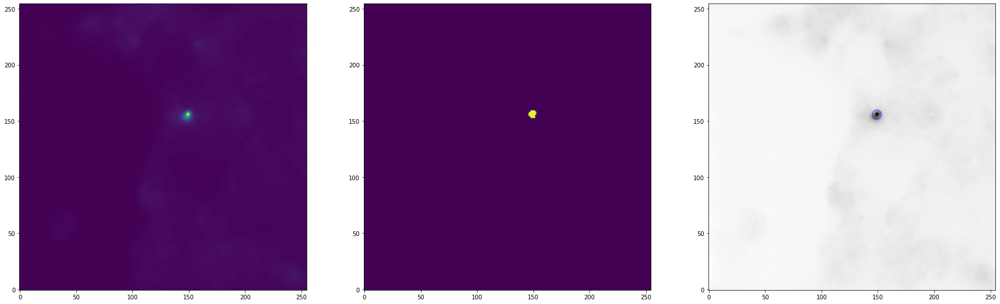

This is image 1
This is image 2


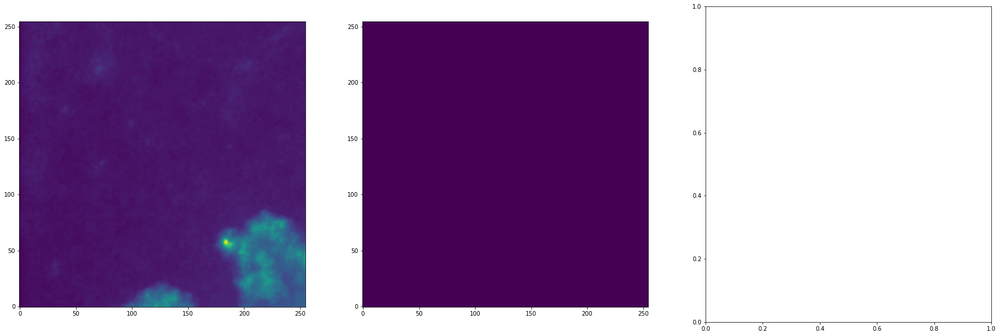

This is image 3


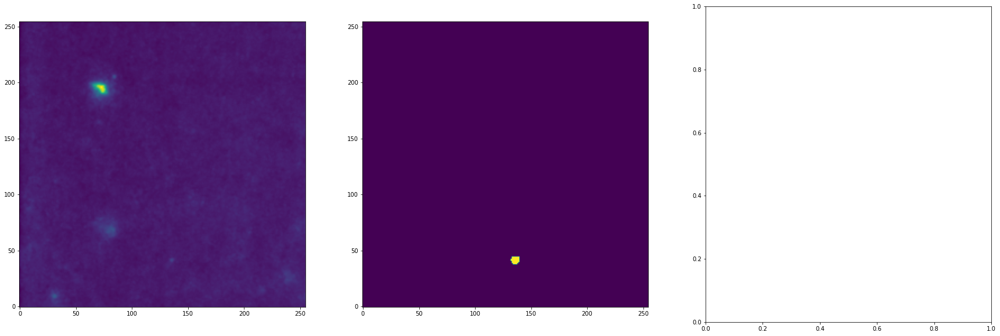

This is image 4


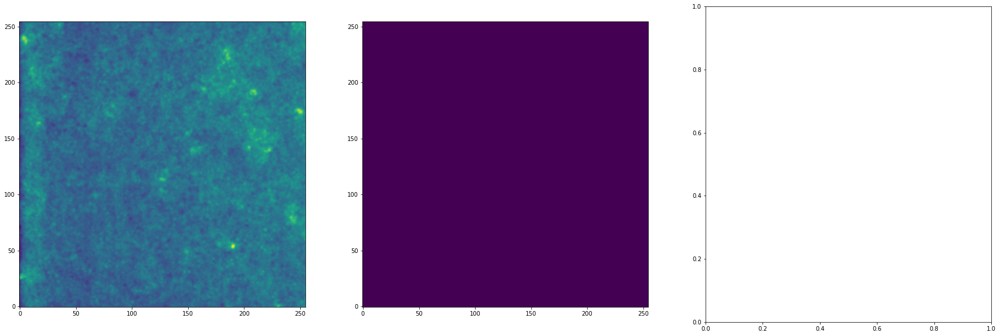

This is image 5


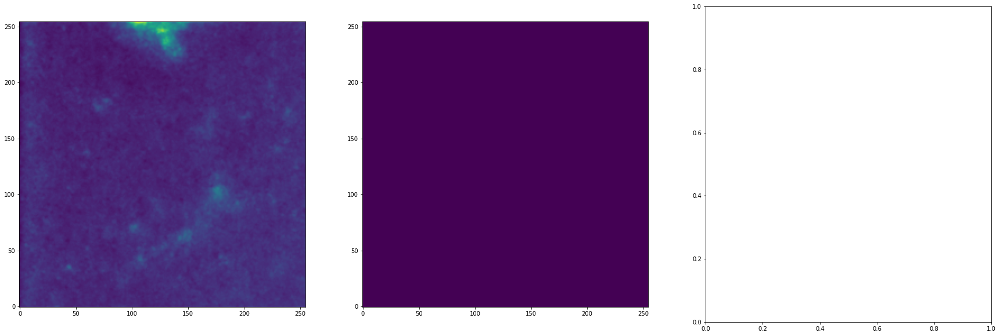

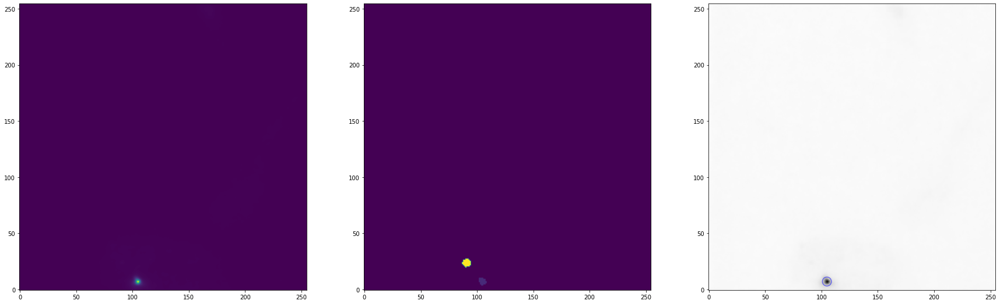

This is image 6
This is image 7


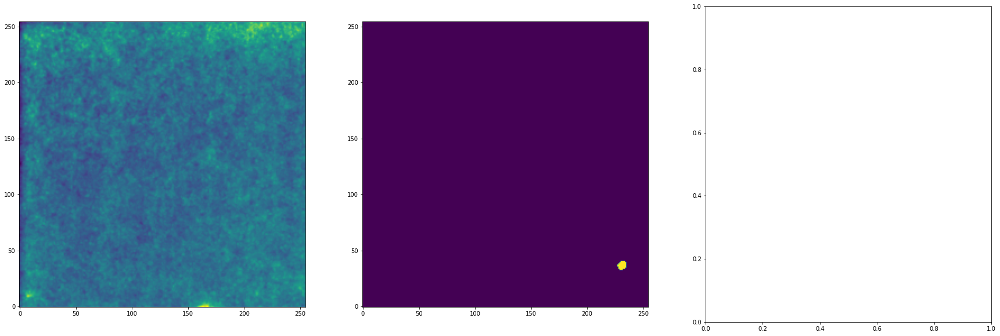

This is image 8


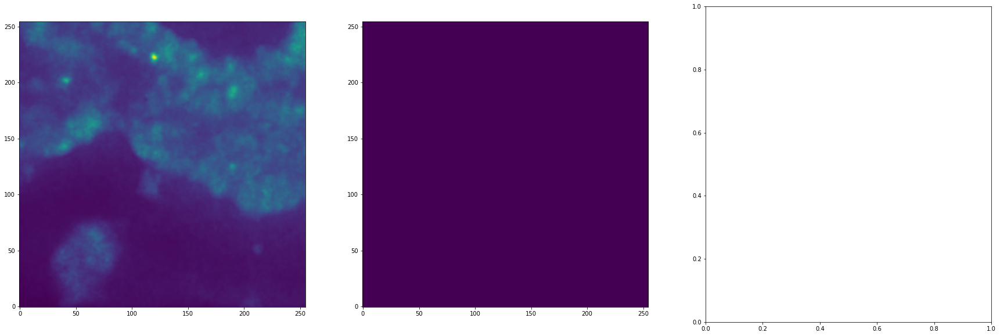

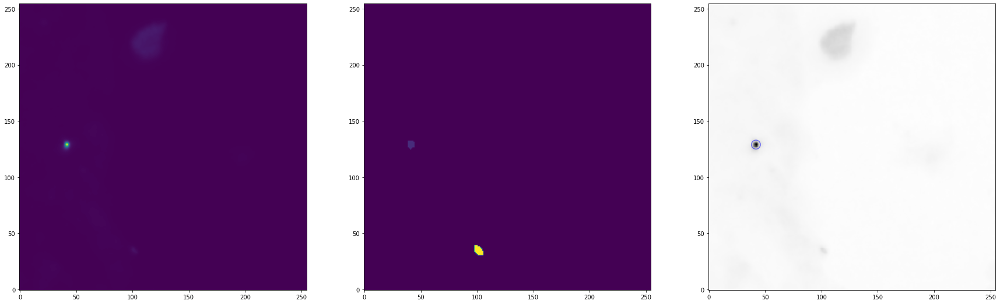

This is image 9
This is image 10


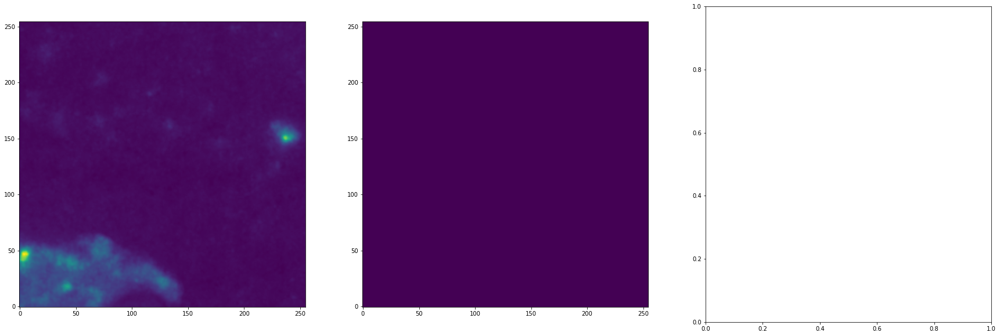

This is image 11


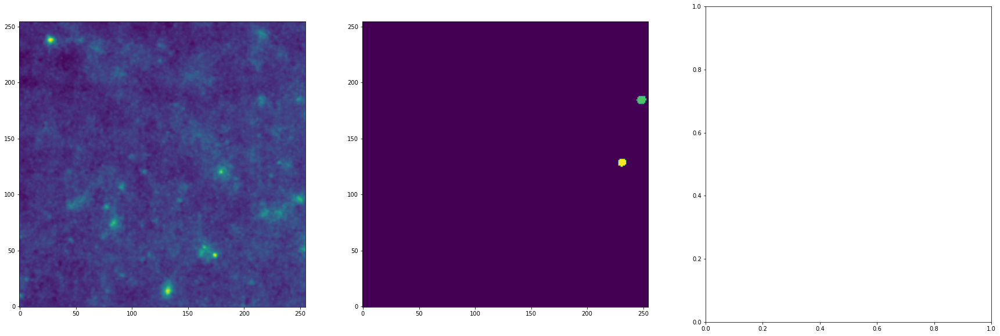

This is image 12


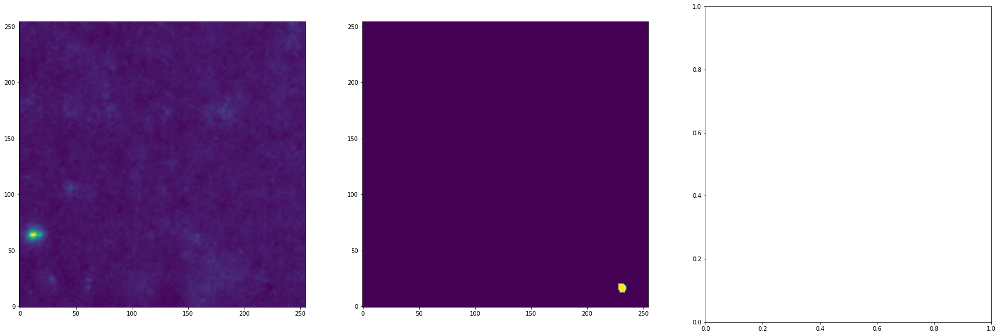

This is image 13


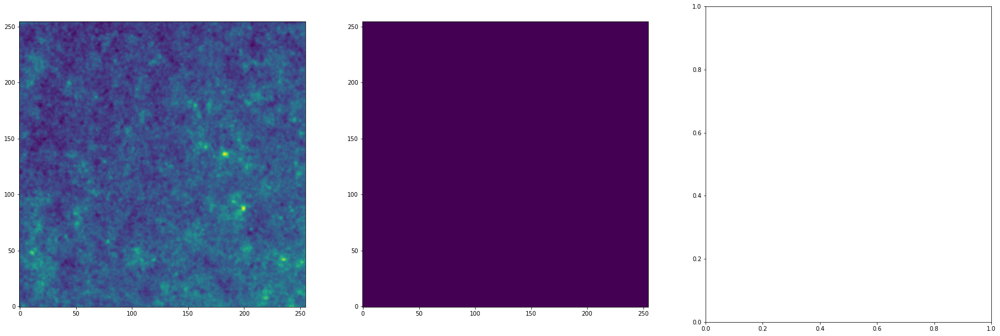

This is image 14


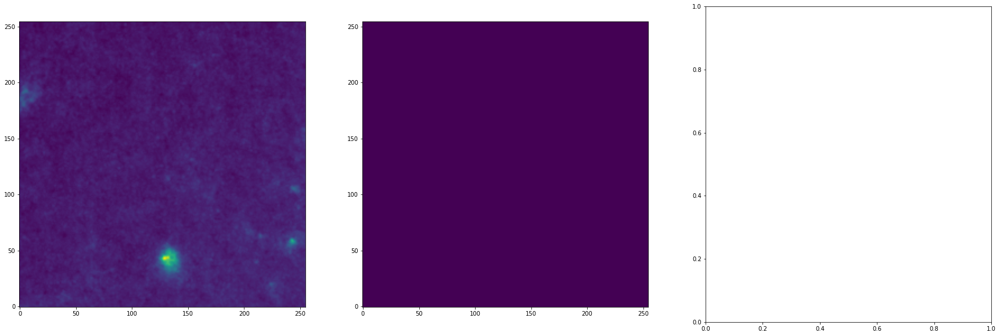

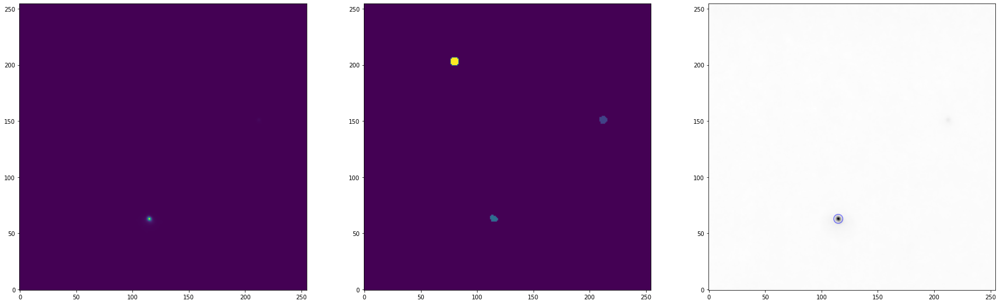

This is image 15
This is image 16


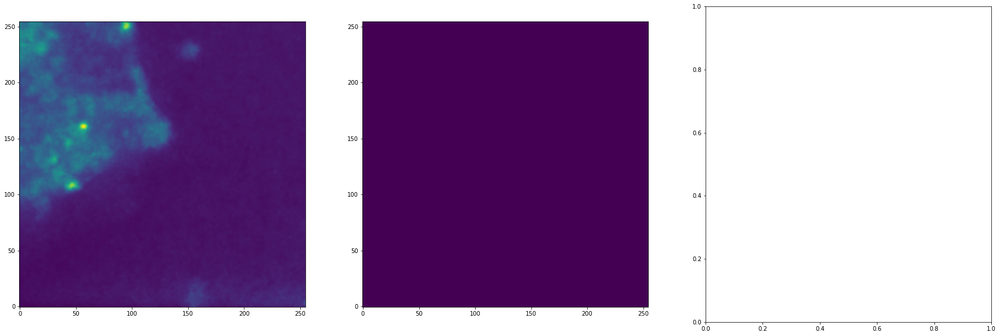

This is image 17


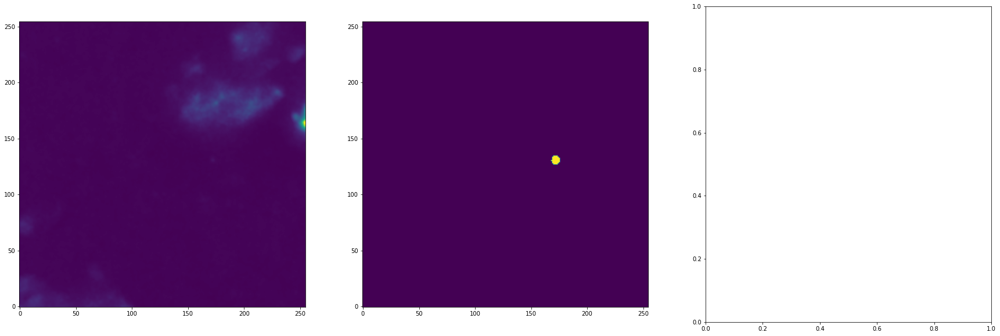

This is image 18


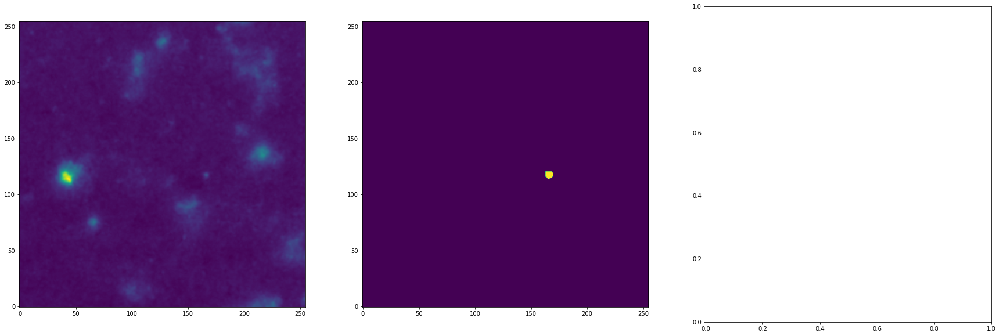

This is image 19


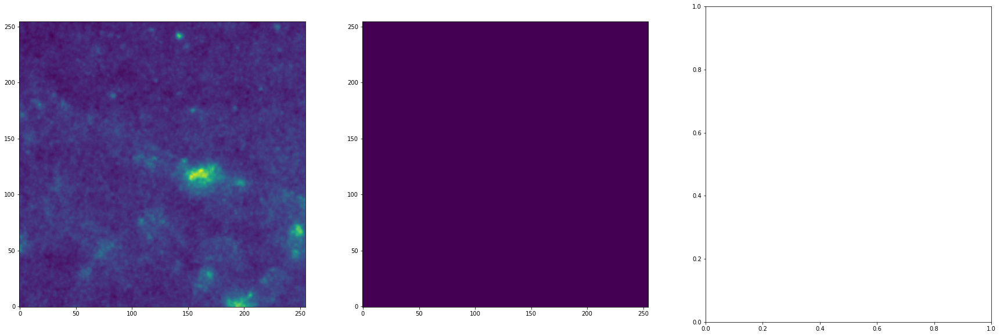

This is image 20


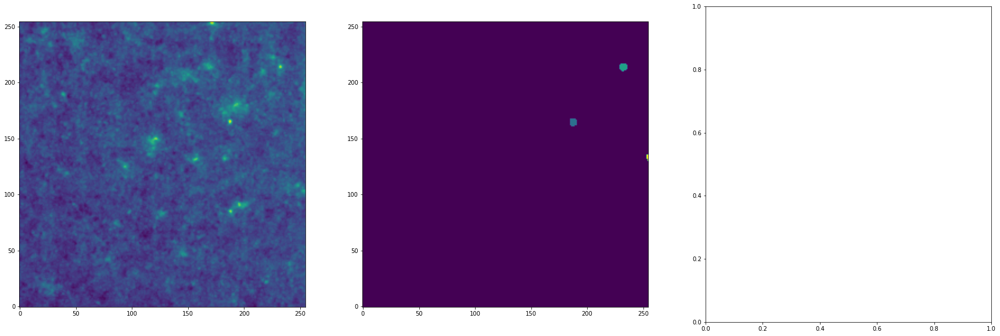

This is image 21


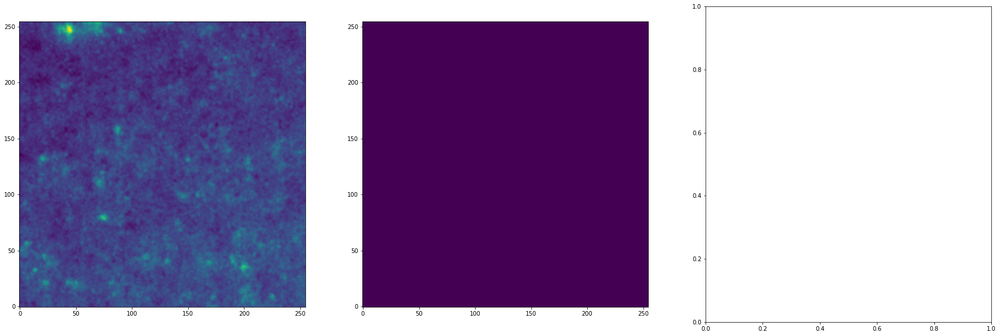

This is image 22


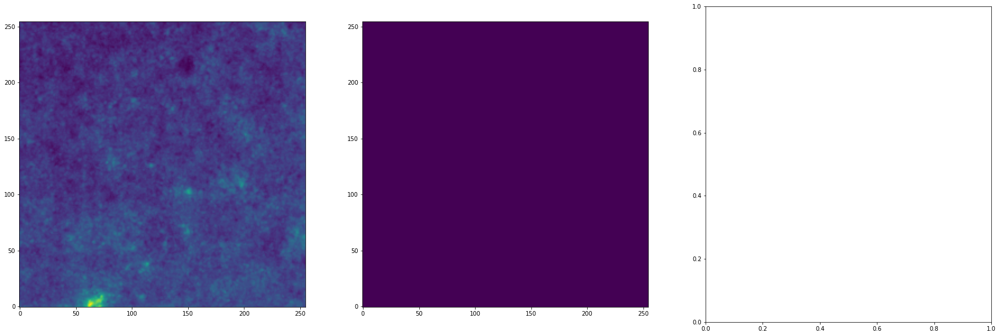

This is image 23


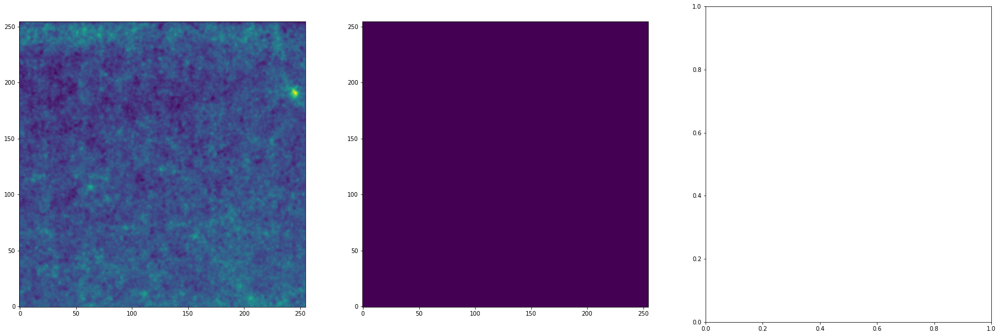

This is image 24


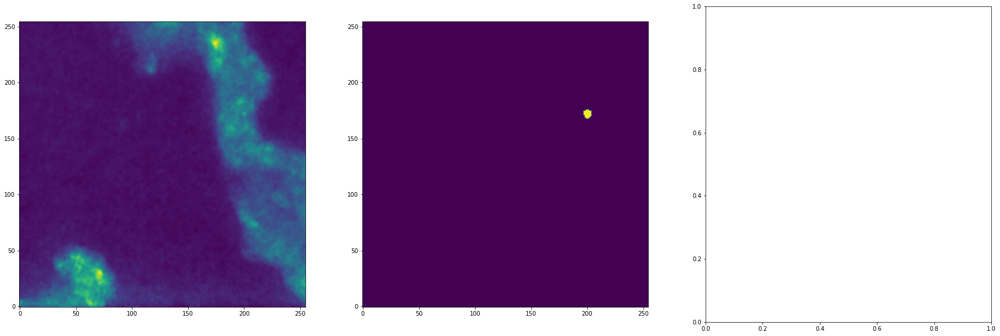

This is image 25


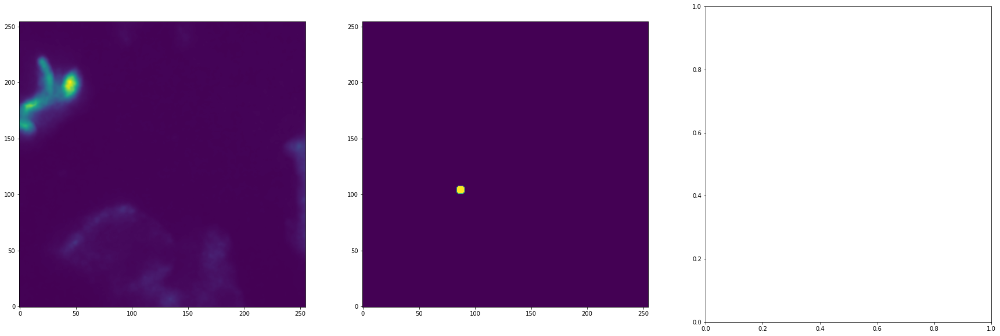

This is image 26


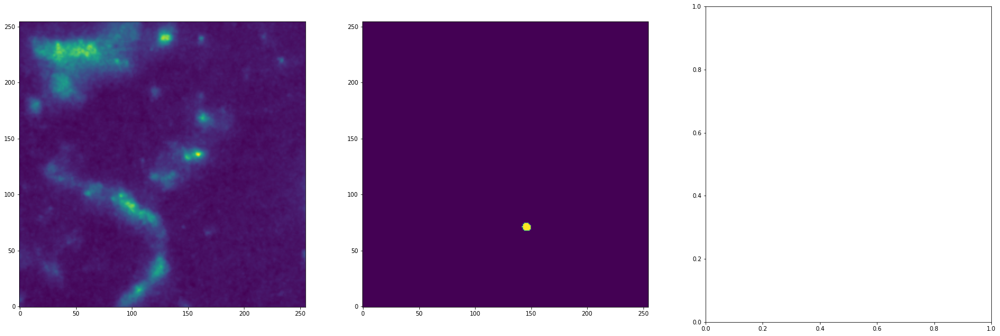

This is image 27


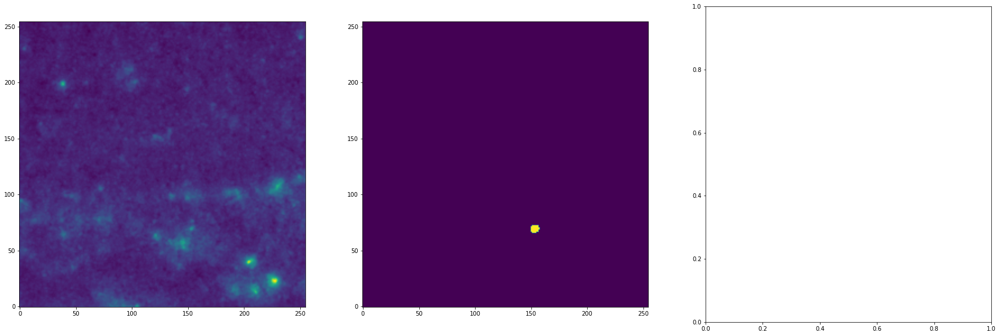

This is image 28


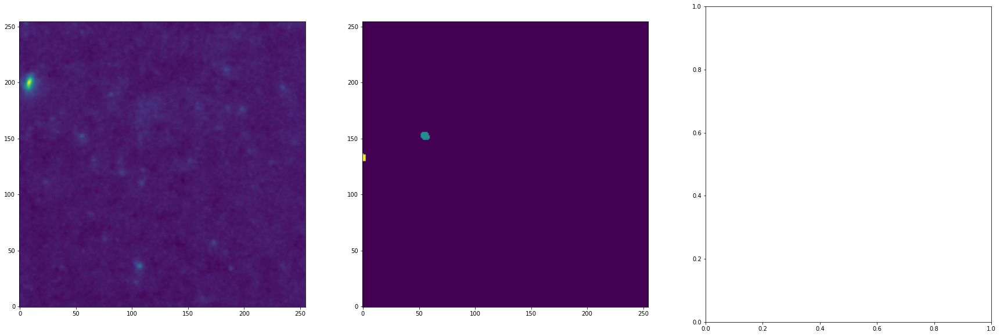

This is image 29


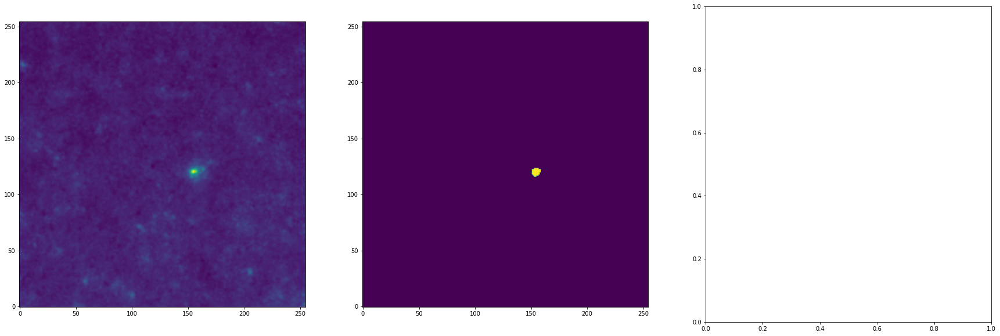

This is image 30


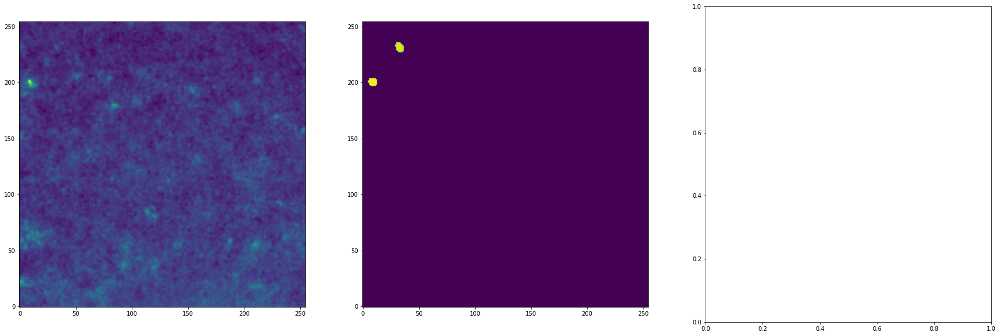

This is image 31


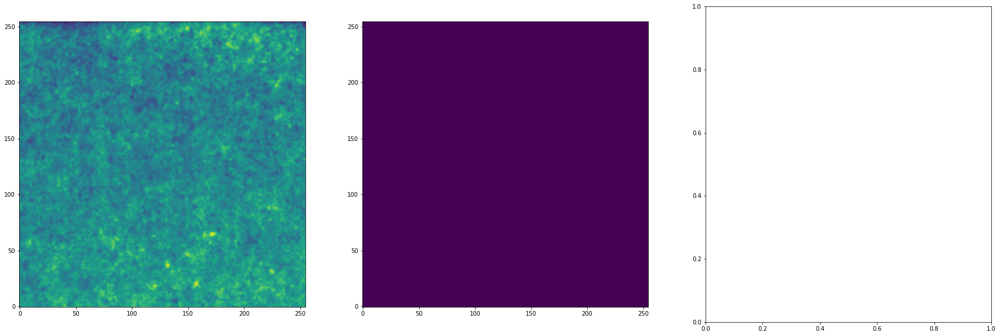

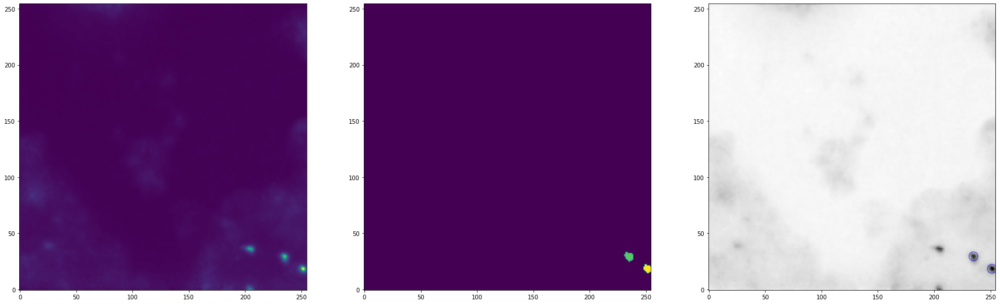

This is image 32


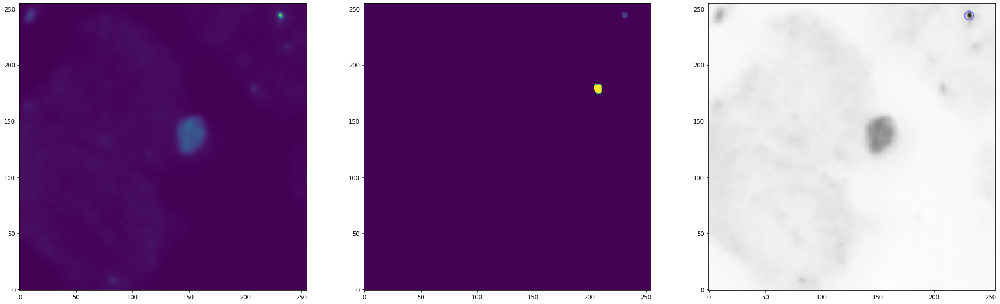

This is image 33
This is image 34


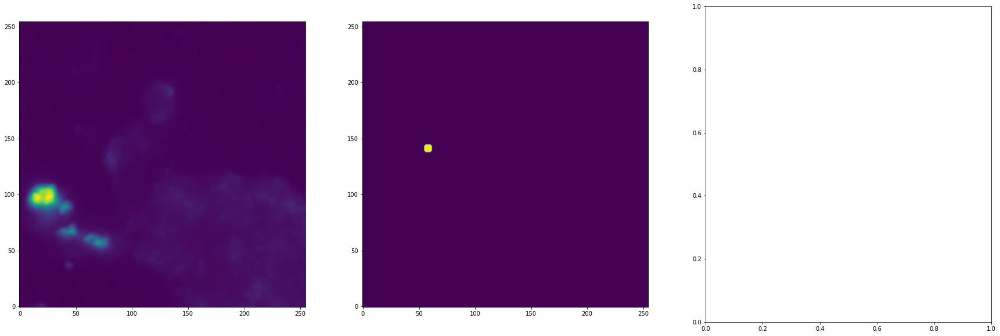

This is image 35


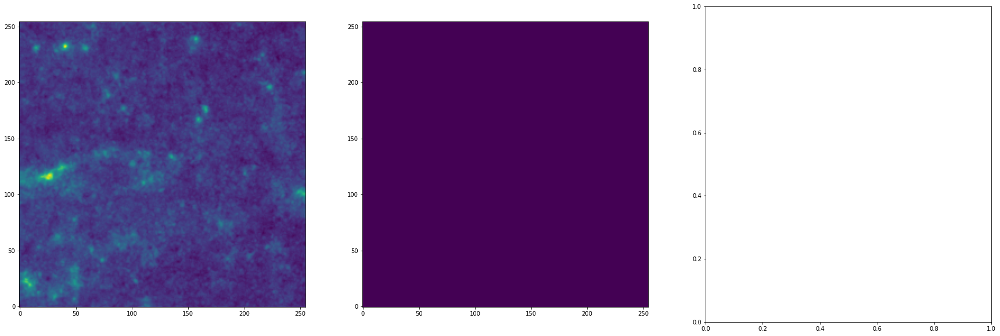

This is image 36


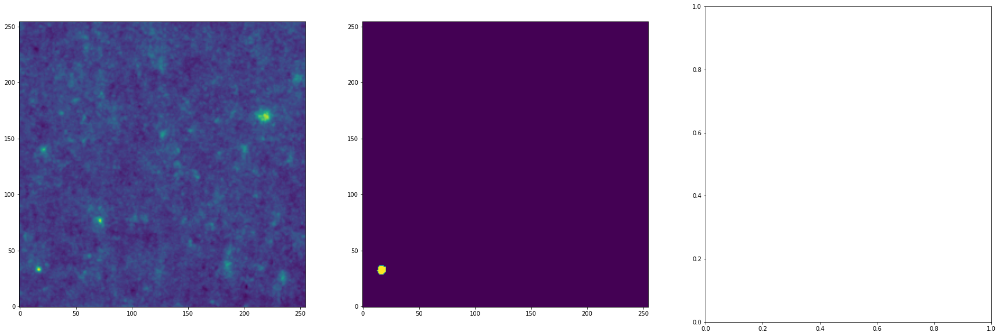

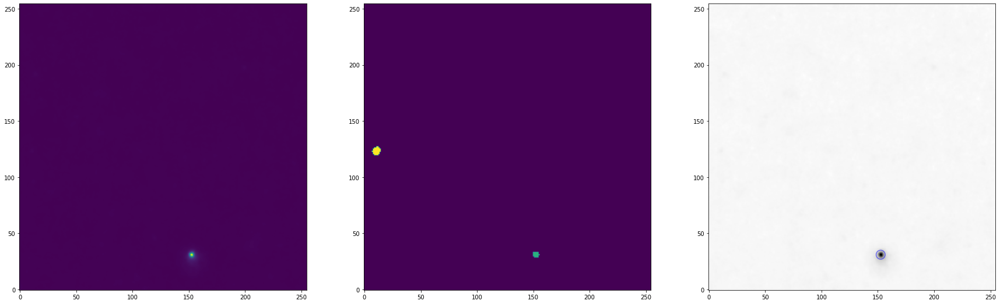

This is image 37
This is image 38


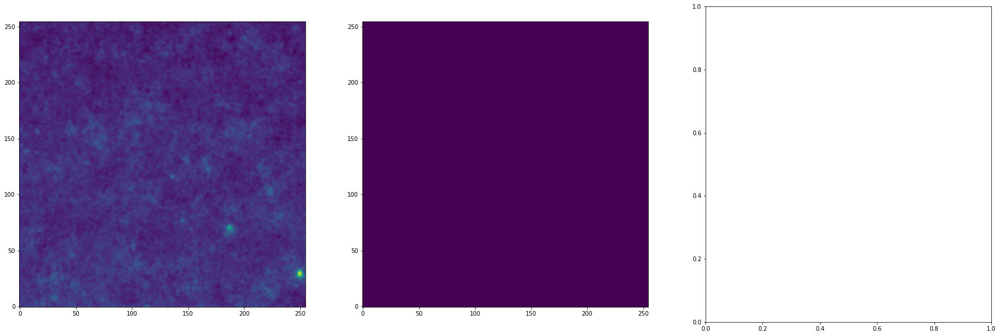

This is image 39


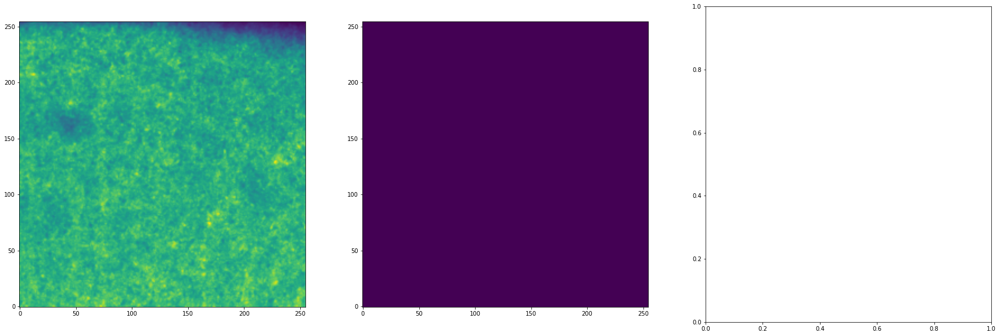

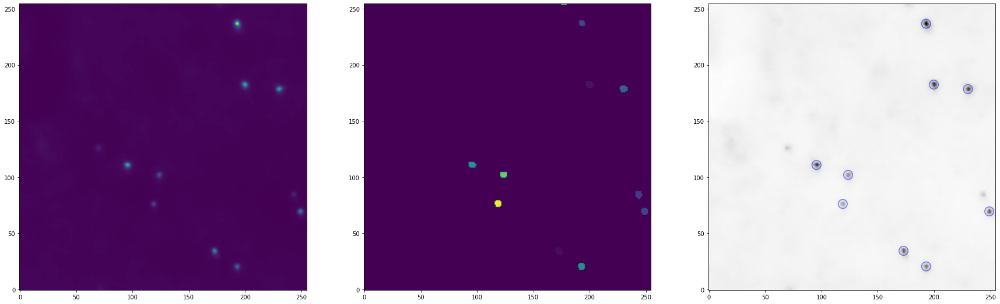

This is image 40


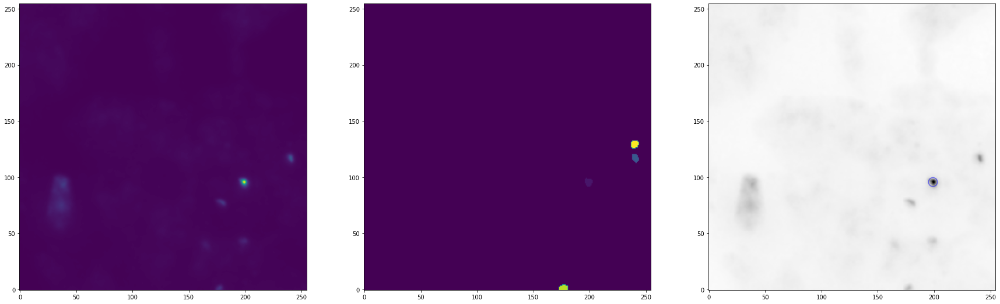

This is image 41
This is image 42


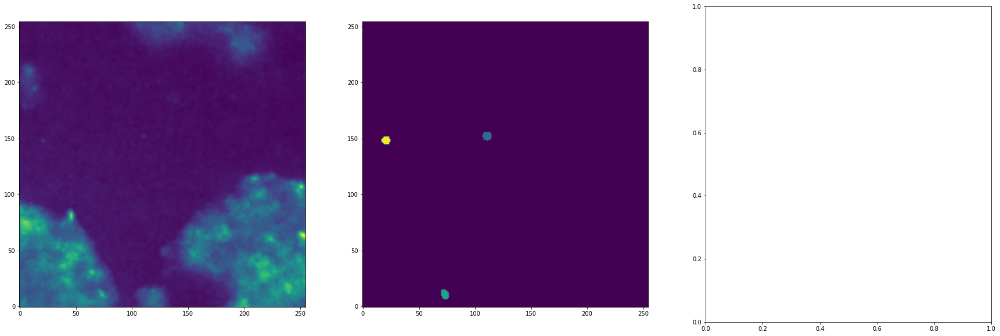

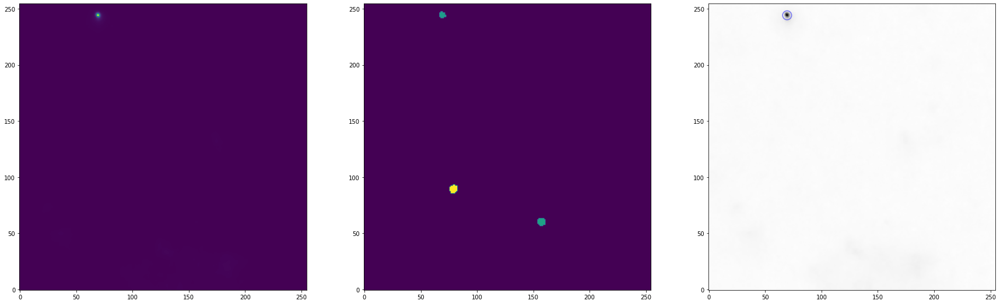

This is image 43
This is image 44


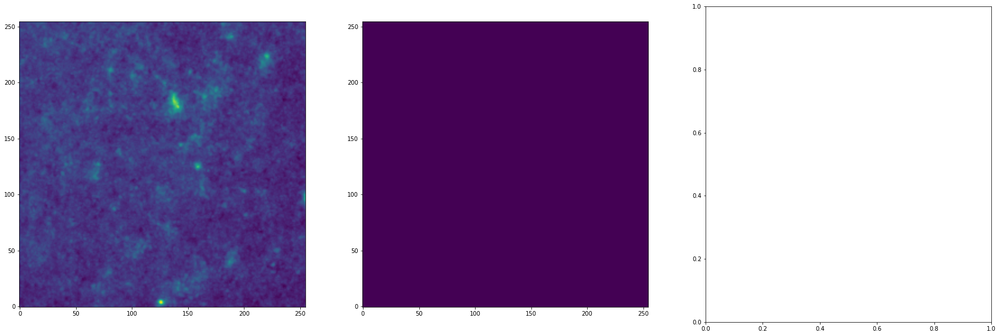

This is image 45


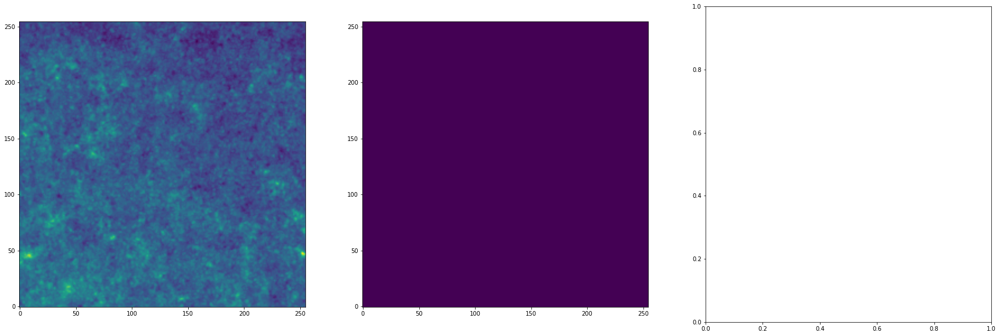

This is image 46


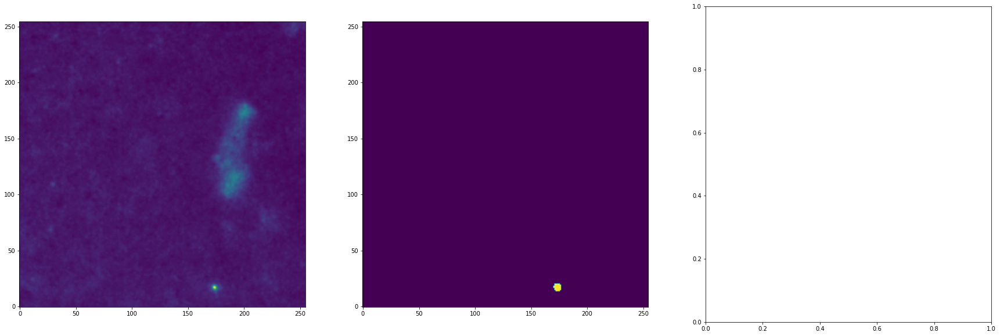

This is image 47


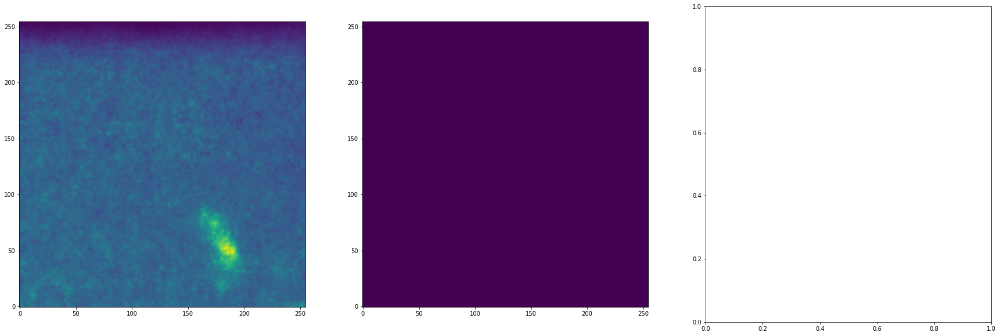

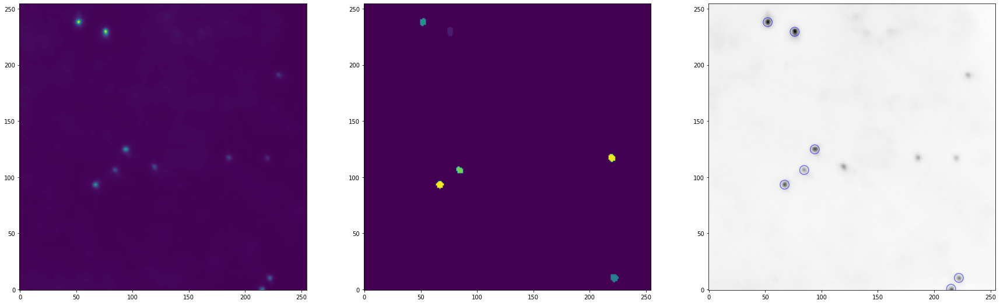

This is image 48


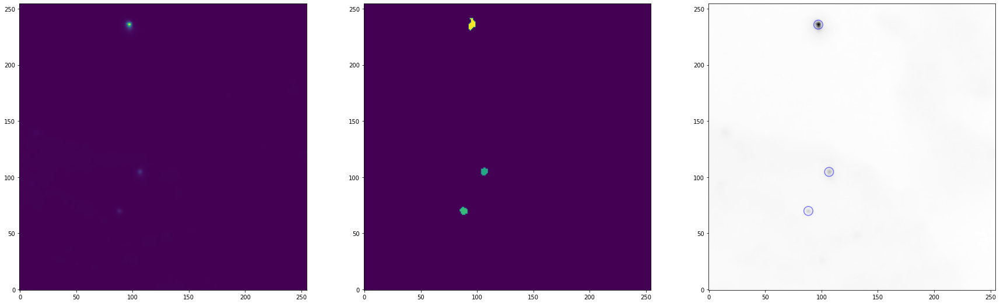

This is image 49
This is image 50


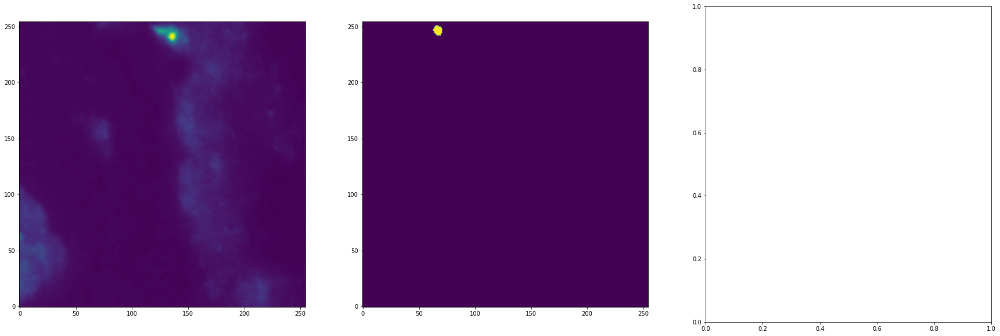

This is image 51


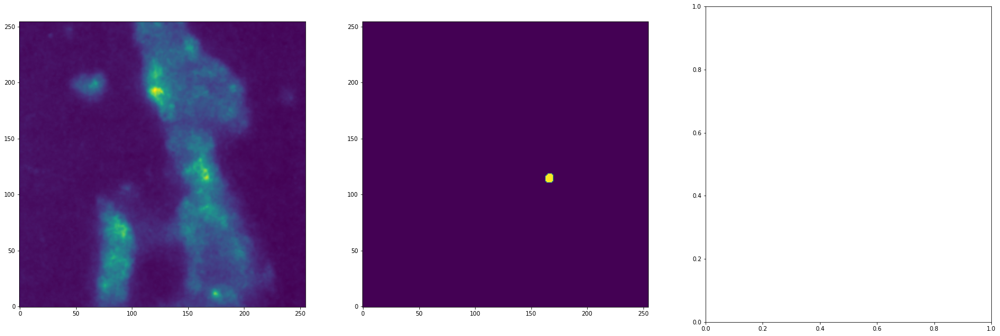

This is image 52


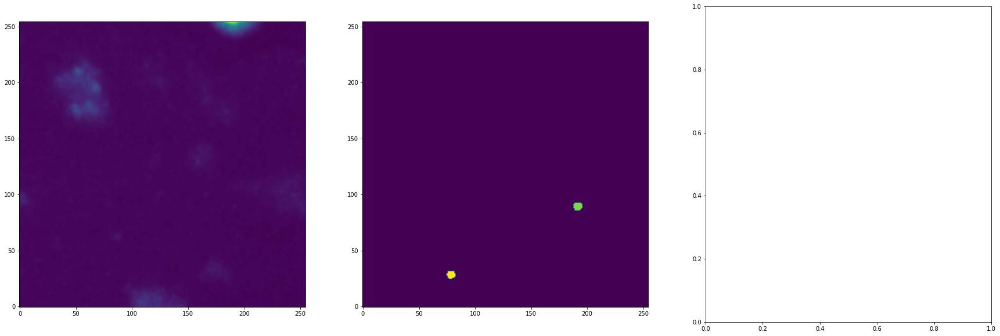

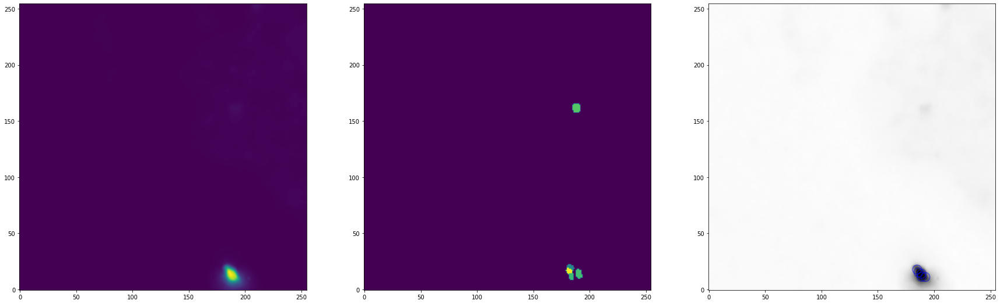

This is image 53


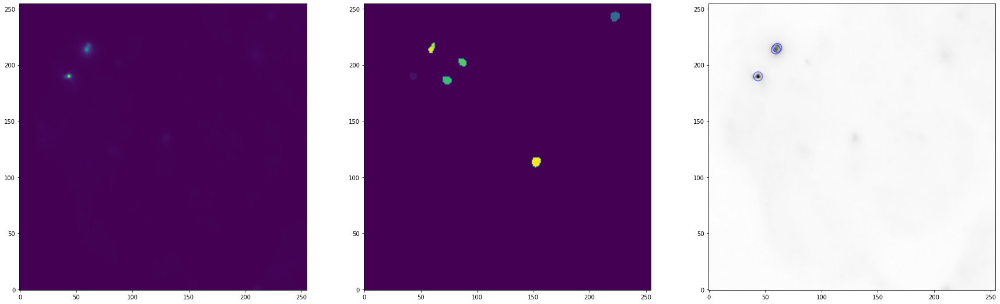

This is image 54


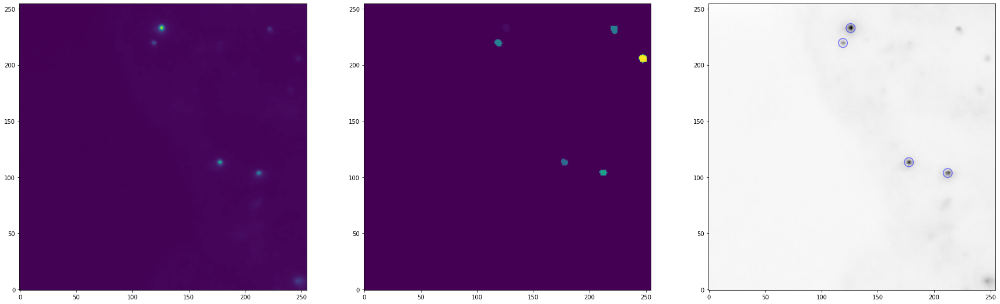

This is image 55


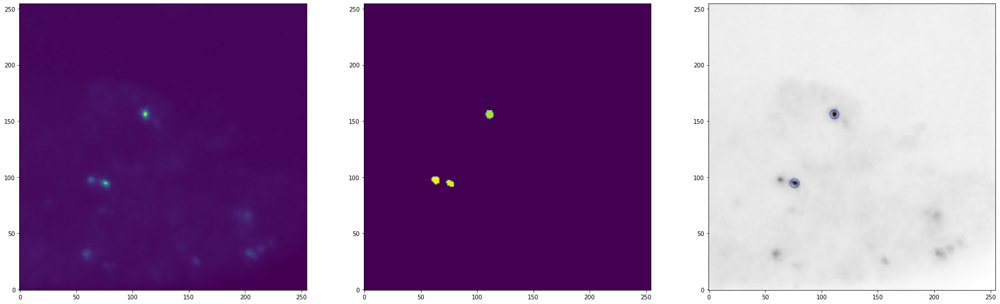

This is image 56
This is image 57


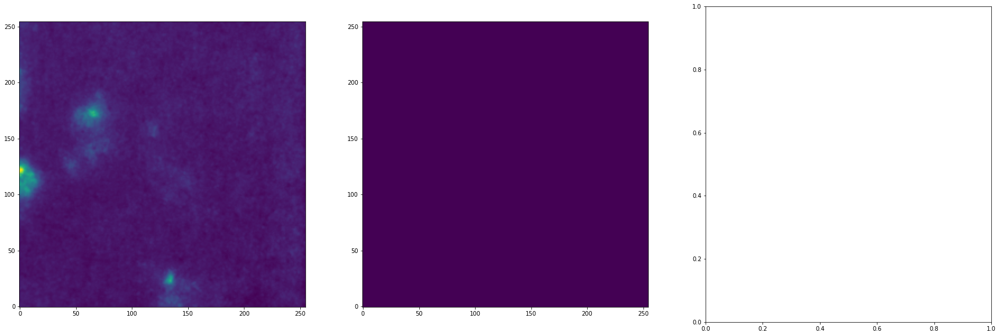

This is image 58


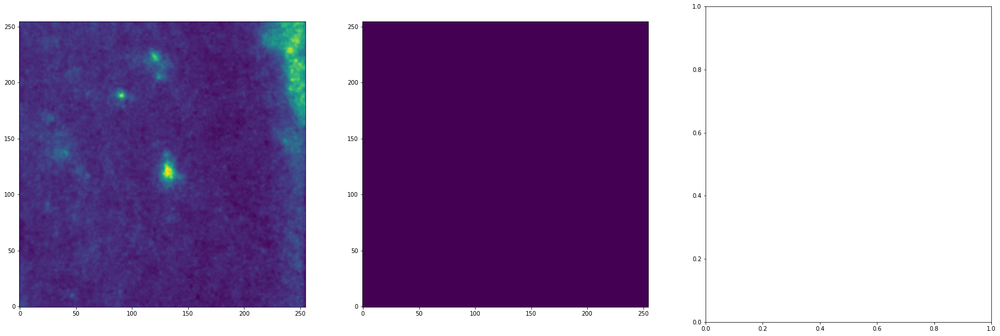

This is image 59


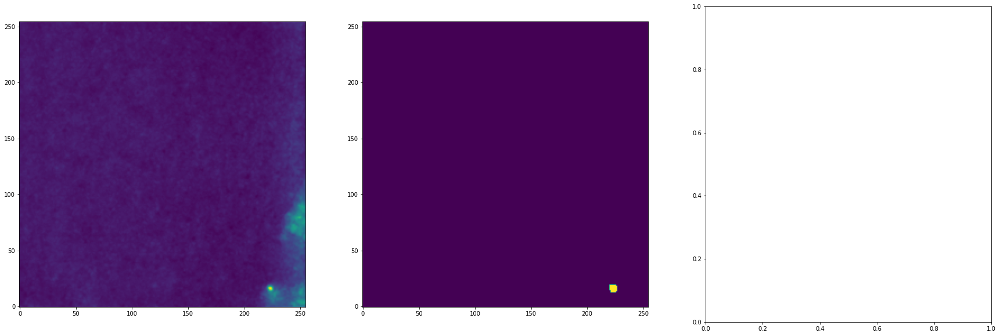

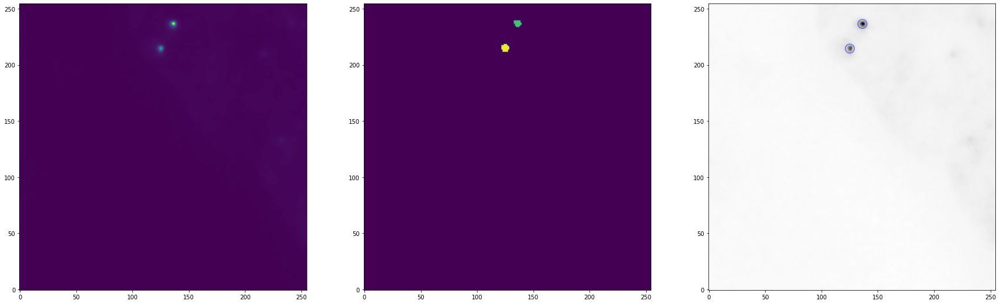

This is image 60


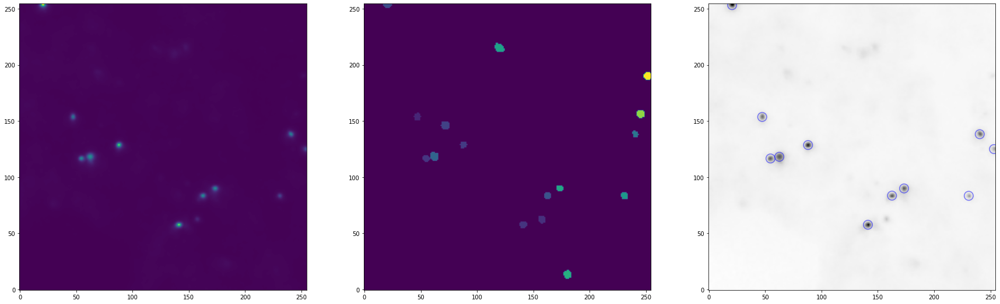

This is image 61


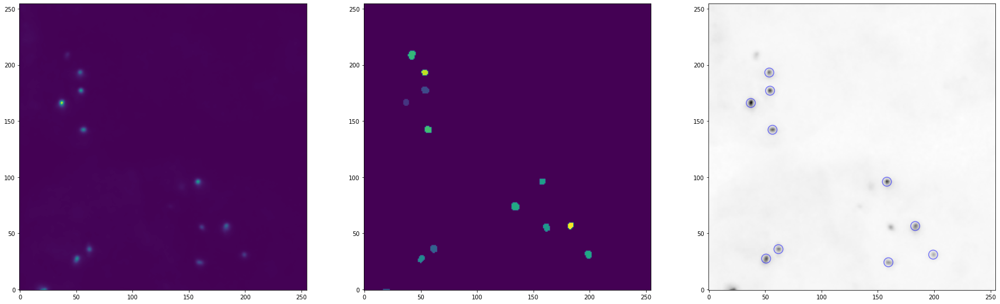

This is image 62


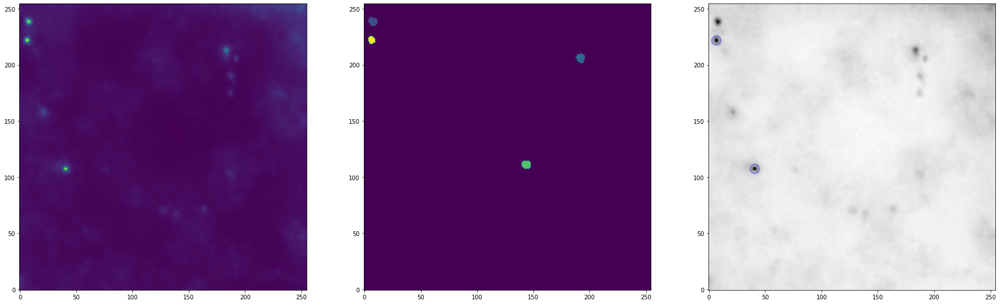

This is image 63


In [453]:
p = 'yes'

for i in range(64):
    
    figure(figsize=(30,10))
    
    plt.subplot(1,3,1)
    
    plt.imshow(images[i],origin="lower")
    #plt.hist(images[i])

    plt.subplot(1,3,2)
    
    plt.imshow(labs[i],origin="lower")

    plt.subplot(1,3,3)
    
    m = findstars(p,images[i],FWHM_best,10)

    #print('The mean intensity for that image is ' + str(round(m[1])))
    print('This is image '+ str(i))
    
    plt.show()

In [457]:
p = 'y'

good_img = []

for i in range(64):
    
    m = findstars(p,images[i],FWHM_best,10)
    
    if len(m) > 1:
        if np.mean(labs[i])> 0:
            good_img.append(labs[i])
            
            print('This is image '+ str(i))
    

This is image 0
This is image 32
This is image 40
This is image 48
This is image 49
This is image 53
This is image 54
This is image 55
This is image 56
This is image 60
This is image 61
This is image 62
This is image 63


Image 40 looks like the best one as it contains a lot of high intensity objects that are well detected 

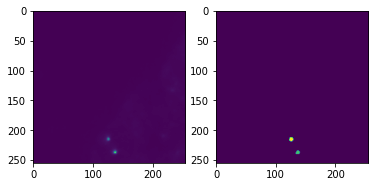

In [554]:
i = 60 
plt.subplot(1,2,1)
plt.imshow(images[i])
plt.subplot(1,2,2)
plt.imshow(labs[i])
plt.show()

In [590]:
raw= np.load('Outputs/raw/scan_002_RT17_004_ROI_converted_decon_ch00_raw.npy')

lab = np.load('Outputs/labeled/scan_002_RT17_004_ROI_converted_decon_ch00_mask.npy')


Crop sequentially the whole stack plane by plane

In [478]:
def crop_3D(image,sizex,sizey):
    
    new_image = []
    plane = image.shape[0]
    print(plane)
    for i in range(plane):
        for row in range(int(image.shape[2]/sizey)):
            for col in range(int(image.shape[1]/sizex)):
                new_image.append(image[i,col+(col*(sizex-1)):col+(col*(sizex-1))+sizex-1,row+(row*(sizey-1)):row+(row*(sizey-1))+sizey-1])

    return new_image

Crop the image stack by stack 

In [483]:
def crop_3D_stack(image,sizex,sizey):
    
    new_image = []
    for row in range(int(image.shape[2]/sizey)):
        for col in range(int(image.shape[1]/sizex)):
            new_image.append(image[0:image.shape[0],col+(col*(sizex-1)):col+(col*(sizex-1))+sizex-1,row+(row*(sizey-1)):row+(row*(sizey-1))+sizey-1])

    return new_image

## Create the template for the sphere abased on one real detected objects

In [591]:
print(np.shape(raw))

images_3D_r = crop_3D_stack(raw,256,256)
images_3D_l = crop_3D_stack(lab,256,256)


print(np.shape(images_3D))

best_image = images_3D_l[60]

m = skimage.measure.regionprops_table(best_image,properties=['slice'])
print(m['slice'])

sphere = best_image[m['slice'][0][0],m['slice'][0][1],m['slice'][0][2]]

print(np.shape(sphere))


(70, 2048, 2048)
(64, 70, 255, 255)
[(slice(24, 30, None), slice(234, 240, None), slice(133, 140, None))
 (slice(26, 31, None), slice(212, 219, None), slice(122, 129, None))]
(6, 6, 7)


## Correct the images (in 3D)

[array([104.79459753,   6.98990127]), array([192.81616375,  20.43439143]), array([152.54386092,  30.90836206]), array([172.82390978,  34.3169317 ]), array([141.21625849,  57.55275018]), array([114.89778512,  62.8409033 ]), array([248.9977116 ,  69.50339333]), array([162.61207236,  83.54289716]), array([173.33376866,  89.93684864]), array([67.20403221, 93.28193996]), array([158.07786571,  95.92594691]), array([198.9935494 ,  95.62130263]), array([106.70774037, 104.67637209]), array([ 95.58713378, 110.86599973]), array([177.61770226, 113.30142274]), array([ 54.68753623, 116.63399759]), array([ 94.00622793, 124.77841673]), array([ 41.74110715, 128.98705608]), array([ 88.01273074, 128.60403848]), array([240.54925474, 138.26355171]), array([149.08918322, 155.78152471]), array([ 37.22936123, 166.11461879]), array([ 54.29154369, 177.04061715]), array([230.07971225, 178.48744882]), array([199.81292211, 182.47953918]), array([ 43.59182923, 189.82292755]), array([ 59.41978187, 213.74184734]), ar

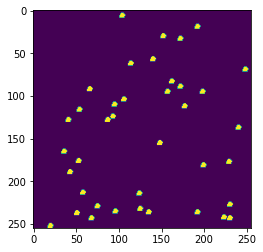

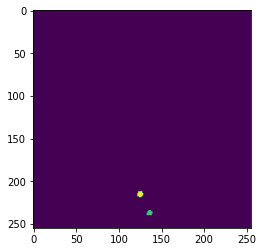

In [596]:
def correction(image,lab_img,sphere):
    #print(np.shape(image)[0])
    new_image = np.zeros((np.shape(image)[0],np.shape(image)[1],np.shape(image)[2]))
    positions = findstars('t',np.max(images,axis=0),3,9)
    print(positions)
    counter = 0
    z = 35
    for pos in positions:
        x = round(list(pos)[1])
        y = round(list(pos)[0])

        if test_labs[x,y] <= 1:
            if x ==1 or y == 1:
                counter = 1 
            else:
                new_image[z-3:z+3,x-4:x+2,y-4:y+3] = sphere
                
    return new_image

#print(np.shape(correction(images_3D_r[60],images_3D_l[60],sphere)))

test = np.max(correction(images_3D_r[60],images_3D_l[60],sphere),axis=0)
plt.imshow(test)
plt.show()

test_2 = np.max(images_3D_l[60],axis=0)
plt.imshow(test_2)
plt.show()